# 후처리 테스스


In [2]:
import segmentation_models_pytorch as smp
import cv2
import torch
import rasterio
import numpy as np
from PIL import Image
from matplotlib import pyplot as plt
from matplotlib.colors import ListedColormap
from torchvision import transforms
import os


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [3]:
####################아래는 원본이미지에만 적용할 전처리####################
# 엣지 보강 (샤프닝)
def enhance_edges(image):
    image = np.array(image)  # PIL Image -> NumPy 배열로 변환
    kernel = np.array([[0, -1, 0],
                       [-1, 5, -1],
                       [0, -1, 0]])
    return Image.fromarray(cv2.filter2D(image, -1, kernel))  # NumPy 배열에서 필터링 후 PIL 이미지로 변환

# 채도 강화
def enhance_saturation(image, scale=1.5):
    image = np.array(image)  # PIL Image -> NumPy 배열로 변환
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)  # RGB -> BGR로 변환
    hsv = cv2.cvtColor(image, cv2.COLOR_BGR2HSV)
    h, s, v = cv2.split(hsv)
    s = cv2.multiply(s, scale)
    s = cv2.min(s, 255)
    hsv = cv2.merge((h, s, v))
    image = cv2.cvtColor(hsv, cv2.COLOR_HSV2BGR)  # BGR -> HSV로 변환 후 다시 BGR로
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # BGR -> RGB 변환
    return Image.fromarray(image)  # 결과를 PIL 이미지로 변환

# CLAHE
def enhance_clahe(image):
    image = np.array(image)  # PIL Image -> NumPy 배열로 변환
    image = cv2.cvtColor(image, cv2.COLOR_RGB2BGR)  # RGB -> BGR로 변환
    lab = cv2.cvtColor(image, cv2.COLOR_BGR2LAB)
    l, a, b = cv2.split(lab)
    clahe = cv2.createCLAHE(clipLimit=1.0, tileGridSize=(2, 2))
    l = clahe.apply(l)
    lab = cv2.merge((l, a, b))
    image = cv2.cvtColor(lab, cv2.COLOR_LAB2BGR)  # LAB -> BGR로 변환 후
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)  # BGR -> RGB 변환
    return Image.fromarray(image)  # 결과를 PIL 이미지로 변환

In [15]:
from sklearn.metrics import precision_score, recall_score, f1_score

def compute_metrics(outputs, masks, num_classes, class_names):
    """
    outputs: [H, W] - Model predictions (class indices)
    masks: [H, W] - Ground truth masks
    num_classes: Number of classes
    class_names: List of class names
    """
    iou_per_class = []
    precision_per_class = []
    recall_per_class = []
    f1_per_class = []
    correct_pixels = 0
    total_pixels = masks.numel()


    for cls in range(num_classes):
        ## IOU
        true_positive = ((outputs == cls) & (masks == cls)).sum().item()
        false_positive = ((outputs == cls) & (masks != cls)).sum().item()
        false_negative = ((outputs != cls) & (masks == cls)).sum().item()

        union = true_positive + false_positive + false_negative
        if union > 0:
            iou_per_class.append(true_positive / union)
        else:
            iou_per_class.append(0.0)

        ## Precision, Recall, F1 score
        pred_binary = (outputs == cls).flatten().cpu().numpy()
        mask_binary = (masks == cls).flatten().cpu().numpy()

        precision = precision_score(mask_binary, pred_binary, zero_division=0)
        recall = recall_score(mask_binary, pred_binary, zero_division=0)
        f1 = f1_score(mask_binary, pred_binary, zero_division=0)

        precision_per_class.append(precision)
        recall_per_class.append(recall)
        f1_per_class.append(f1)

    # Pixel Accuracy
    correct_pixels = (outputs == masks).sum().item()
    mean_iou = sum(iou_per_class) / num_classes
    pixel_accuracy = correct_pixels / total_pixels

    # Print metrics for each class
    for i, iou in enumerate(iou_per_class):
        print(f"Class {class_names[i]}: IoU={iou_per_class[i]:.4f}, Precision={precision_per_class[i]:.4f}, Recall={recall_per_class[i]:.4f}, F1-Score={f1_per_class[i]:.4f}")

    print(f"\nOverall Metrics: Mean IoU={mean_iou:.4f}, Pixel Accuracy={pixel_accuracy:.4f}")

    return mean_iou, pixel_accuracy, precision_per_class, recall_per_class, f1_per_class

## 레이블 맵

In [16]:
def load_trained_model(weight_path, num_classes, device):
    model = smp.Segformer(
        encoder_name="mit_b3",
        encoder_weights=None,
        classes=num_classes,
        activation=None
    )
    model.load_state_dict(torch.load(weight_path, map_location=device))
    model = model.to(device)
    model.eval()
    return model

def preprocess_image(image, image_transform):
    image = Image.fromarray(image).convert("RGB")
    image = image_transform(image)
    return image.unsqueeze(0)

def preprocess_mask(mask, class_mapping):
    mask_array = np.array(mask)
    mapped_mask = np.zeros_like(mask_array, dtype=np.uint8)
    for old_class, new_class in class_mapping.items():
        mapped_mask[mask_array == old_class] = new_class
    return torch.tensor(mapped_mask, dtype=torch.long)

def visualize_result(image, prediction, colormap, class_names, title="Prediction"):
    cmap = ListedColormap(np.array(colormap) / 255.0)
    plt.figure(figsize=(12, 6))
    plt.subplot(1, 2, 1)
    plt.title("Original Image")
    plt.imshow(image)
    plt.axis("off")
    plt.subplot(1, 2, 2)
    plt.title(title)
    plt.imshow(prediction, cmap=cmap)
    plt.axis("off")
    patches = [plt.Line2D([0], [0], color=np.array(c) / 255, lw=4) for c in colormap]
    plt.legend(patches, class_names, loc="upper center", bbox_to_anchor=(0.5, -0.05), ncol=5)
    plt.show()

## Post Prcessing 함수

In [17]:
#노이즈 제거, 블러링
def postprocess_segmentation(mask, kernel_size, blur_ksize):
    mask = mask.astype(np.uint8)
    kernel = np.ones((kernel_size, kernel_size), np.uint8)
    mask_cleaned = cv2.morphologyEx(mask, cv2.MORPH_OPEN, kernel)

    mask_blurred = cv2.GaussianBlur(mask_cleaned, (blur_ksize, blur_ksize), 0)

    return mask_blurred

#엣지 검출
def create_edge_map(image, low_threshold, high_threshold):
    gray_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray_image, low_threshold, high_threshold)
    return edges

#####################탐색 판단 알고리즘#######################
def refine_labels(edge_map, label_map, num_classes, class_mapping):
    height, width = edge_map.shape
    refined_label_map = np.copy(label_map)
    DR = 0.7  # Dominative Rate 설정

    # 8방향 탐색을 위한 델타값 설정
    directions = [(-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)]

    for y in range(1, height - 1):
        for x in range(1, width - 1):
            if edge_map[y, x] == 255:  #강한 에지 픽셀인 경우
                current_label = label_map[y, x]
                labels_around = [label_map[y + dy][x + dx] for dy, dx in directions]
                label_counts = np.bincount(labels_around, minlength=num_classes)
                max_label = np.argmax(label_counts)

                # 조건 1: 주변에서 가장 많이 나타난 레이블로 변경
                if max_label != current_label:
                    refined_label_map[y, x] = max_label
                    continue

                # 조건 2: 경계직선화 : DR 적용
                a = np.sum(np.array(labels_around) != current_label)
                b = label_counts[max_label]
                distance = np.sum(label_counts)

                if a < b and b/distance >= DR:
                    refined_label_map[y, x] = max_label
                    continue

                # 조건 3 : 작은 영역 (노이즈 제거)
                if len(label_counts) > 2:
                    second_max_label = np.argsort(label_counts)[-2]
                    if b <= 5 and refined_label_map[y, x] == second_max_label:
                        refined_label_map[y, x] = max_label

                # 예: 연속된 레이블 변화 확인, 레이블 지배도 검사 등
    return refined_label_map
############################################################

#불확실성 기반 후처리
def uncertainty_based_refine(prediction, softmax_output, threshold):
    refined_prediction = prediction.copy()

    # 확신이 낮은 픽셀 찾기 (softmax 값이 threshold보다 낮으면 불확실)
    max_confidence = np.max(softmax_output, axis=1)
    uncertainty_mask = np.squeeze(max_confidence < threshold)  # 가장 높은 확률 값과 threshold 비교

    height, width = prediction.shape
    directions = [(-1, 0), (1, 0), (0, -1), (0, 1), (-1, -1), (-1, 1), (1, -1), (1, 1)]

    for y in range(1, height - 1):
        for x in range(1, width - 1):
            if bool(uncertainty_mask[y, x]) : # 불확실한 픽셀일 경우
                surrounding_labels = [prediction[y + dy, x + dx] for dy, dx in directions]
                refined_prediction[y, x] = np.bincount(surrounding_labels).argmax()  # 주변에서 가장 많이 등장한 레이블로 변경

    return refined_prediction

# 도로 중점 불확실성 기반 후처리
def uncertainty_based_road_refine(prediction, softmax_output, threshold):
    refined_prediction = prediction.copy()

    # 도로 클래스(1)에서 확신이 낮은 픽셀 찾기
    road_class = 1
    max_confidence = np.max(softmax_output, axis=1)
    uncertainty_mask = (prediction == road_class) & (max_confidence < threshold)
    uncertainty_mask = np.squeeze(uncertainty_mask.astype(bool))

    # 주변 픽셀에서 가장 많이 등장하는 클래스로 보정
    height, width = prediction.shape
    directions = [(-1, 0), (1, 0), (0, -1), (0, 1), (-1, -1), (-1, 1), (1, -1), (1, 1)]

    for y in range(1, height - 1):
        for x in range(1, width - 1):
            if uncertainty_mask[y, x]:
                surrounding_labels = [prediction[y + dy, x + dx] for dy, dx in directions]
                refined_prediction[y, x] = np.bincount(surrounding_labels).argmax()  # 다수결 결정

    return refined_prediction


## 엣지 기반 후처리 보완

In [18]:
#엣지 검출
def create_edge_map(image, low_threshold, high_threshold):
    gray_image = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    edges = cv2.Canny(gray_image, low_threshold, high_threshold)
    return edges

def refine_labels2(edge_map, label_map, num_classes, class_mapping, DR=0.9):
    height, width = edge_map.shape
    refined_label_map = np.copy(label_map)

    # 8방향 탐색을 위한 델타값 설정
    directions = [(-1, -1), (-1, 0), (-1, 1), (0, -1), (0, 1), (1, -1), (1, 0), (1, 1)]

    for y in range(1, height - 1):
        for x in range(1, width - 1):
            edge_intensity = edge_map[y, x]

            if edge_intensity > 50:  # 경계 픽셀인 경우만 적용
                current_label = label_map[y, x]
                labels_around = [label_map[y + dy][x + dx] for dy, dx in directions]
                label_counts = np.bincount(labels_around, minlength=num_classes)
                max_label = np.argmax(label_counts)
                dominant_ratio = label_counts[max_label] / sum(label_counts)

                # ✅ 1. 다수결 판단 (Dominative Rate 기반)
                if dominant_ratio > DR and max_label != current_label:
                    refined_label_map[y, x] = max_label
                    continue

                # ✅ 2. 연속된 변화가 적은 경우 유지 (노이즈 방지)
                if labels_around.count(current_label) >= 5:  # 주변 8픽셀 중 5개 이상 동일
                    continue

                # ✅ 3. 도로(1)와 필드(2) 클래스 유지 조건
                if current_label == 1 and label_counts[1] >= 3:  # 도로 유지
                    continue
                if current_label == 2 and label_counts[2] >= 5:  # 필드 유지
                    continue

                # ✅ 4. 강한 에지(255)와 약한 에지(128 이하) 구분
                if edge_intensity >= 200:  # 강한 경계 → 바로 다수결
                    refined_label_map[y, x] = max_label
                elif edge_intensity <= 100:  # 약한 경계 → 변화 적으면 유지
                    if labels_around.count(current_label) >= 4:
                        continue
                    refined_label_map[y, x] = max_label

    return refined_label_map


In [132]:
# 컨투어링 직선화
def contour_simplification(label_map, epsilon, road_class = 1):
    refined_label_map = np.copy(label_map)
    # 도로(1) 클래스만 선택
    road_mask = (label_map == road_class).astype(np.uint8)
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_TC89_KCOS)

    approx_mask = np.zeros_like(road_mask)
    for contour in contours:
        approx = cv2.approxPolyDP(contour, epsilon, True)  # 직선화된 컨투어 생성
        cv2.drawContours(approx_mask, [approx], -1, 1, thickness=cv2.FILLED)

    refined_label_map[approx_mask == 1] = road_class

    return refined_label_map

# Softmax 확률 기반 도로 복원
def adaptive_road_filling(prediction, softmax_output, base_threshold, road_class):
    refined_prediction = prediction.copy()
    road_prob = softmax_output[0, road_class, :, :]

    #임계값 적용 (도로 중심부,경계부 따로 적용)
    high_confidence_threshold = 0.5  # 중심부
    low_confidence_threshold = base_threshold  # 경계부 (=기본값)

    # 기존 도로 영역 확장
    high_confidence_mask = (road_prob > high_confidence_threshold) & (prediction == road_class)

    # 주변 도로 예측을 확장
    low_confidence_mask = (road_prob > low_confidence_threshold) & (prediction != road_class)

    refined_prediction[high_confidence_mask] = road_class
    refined_prediction[low_confidence_mask] = road_class

    return refined_prediction

# 엣지맵 기반 신뢰도 강화
def refine_road_with_edges(prediction, softmax_output, edge_map, threshold, road_class):
    refined_prediction = prediction.copy()
    road_prob = softmax_output[0, road_class, :, :]

    # 도로 예측값이 임계값 이상이고, 엣지맵에서도 검출된 영역만 보정
    edge_road_mask = (road_prob > threshold) & (edge_map > 0)
    refined_prediction[edge_road_mask] = road_class

    return refined_prediction

# 방향성 고려하여 보정 (PCA 기반)
def directional_road_filter(label_map, road_class, min_length, angle_threshold, neighborhood_size):
    height, width = label_map.shape
    road_mask = (label_map == road_class).astype(np.uint8)
    contours, _ = cv2.findContours(road_mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    refined_label_map = label_map.copy()
    directions = [(dy, dx) for dy in range(-neighborhood_size, neighborhood_size + 1)
                            for dx in range(-neighborhood_size, neighborhood_size + 1)
                            if not (dy == 0 and dx == 0)]  # 중심 제외

    for contour in contours:
        if len(contour) < min_length:
            continue

        contour_points = contour[:, 0, :]
        mean_x, mean_y = np.mean(contour_points, axis=0)
        cov_matrix = np.cov(contour_points.T)
        eig_values, eig_vectors = np.linalg.eig(cov_matrix)
        principal_direction = eig_vectors[:, np.argmax(eig_values)]
        road_angle = np.arctan2(principal_direction[1], principal_direction[0]) * (180 / np.pi)

        for point in contour_points:
            x, y = point
            if 0 <= y < height and 0 <= x < width:
                surrounding_labels = []
                surrounding_angles = []

                for dy, dx in directions:
                    ny, nx = y + dy, x + dx
                    if 0 <= ny < height and 0 <= nx < width:
                        surrounding_labels.append(label_map[ny, nx])
                        surrounding_angles.append(np.arctan2(dy, dx) * (180 / np.pi))

                if surrounding_labels:
                    most_common_label = np.bincount(surrounding_labels).argmax()
                    angle_diffs = np.abs(np.array(surrounding_angles) - road_angle)
                    aligned_count = np.sum(angle_diffs < angle_threshold)

                    # 방향성이 유지되는 경우 도로 유지
                    if aligned_count / len(surrounding_angles) > 0.5:
                        refined_label_map[y, x] = road_class
                    else:
                        refined_label_map[y, x] = most_common_label

    return refined_label_map

def road_hough_line_filling(road_mask, min_line_length, max_line_gap):
    # ✅ Canny 엣지 검출
    edges = cv2.Canny((road_mask * 255).astype(np.uint8), 200, 400)

    # ✅ Hough Transform을 사용하여 선 감지
    lines = cv2.HoughLinesP(edges, 1, np.pi/180, threshold=30, minLineLength=min_line_length, maxLineGap=max_line_gap)

    if lines is not None:
        for line in lines:
            x1, y1, x2, y2 = line[0]
            cv2.line(road_mask, (x1, y1), (x2, y2), 1, thickness=1)  # 도로 연결

    return road_mask

def road_gap_filling(label_map, road_class, kernel_size, iterations):
    road_mask = (label_map == road_class).astype(np.uint8)

    # ✅ 1. 작은 도로 끊김 해결 (모폴로지 닫기 연산)
    kernel = np.ones((kernel_size, kernel_size), np.uint8)
    closed_road = cv2.morphologyEx(road_mask, cv2.MORPH_CLOSE, kernel, iterations=iterations)

    # ✅ 2. 작은 도로 확장 (팽창 후 침식)
    dilated_road = cv2.dilate(closed_road, kernel, iterations=1)
    refined_road = cv2.erode(dilated_road, kernel, iterations=1)

    label_map[refined_road > 0] = road_class
    return label_map
##########################################################################################
def skeletonize_opencv(binary_mask):
    binary_mask = binary_mask.astype(np.uint8)
    skeleton = np.zeros_like(binary_mask)  # 빈 이미지 생성
    temp = binary_mask.copy()

    # OpenCV_Morphological Thinning 적용
    while True:
        eroded = cv2.erode(temp, np.ones((3, 3), np.uint8))
        temp = temp - eroded
        skeleton = np.maximum(skeleton, temp)
        temp = eroded.copy()
        if cv2.countNonZero(temp) == 0:
            break

    return skeleton


C:\Users\SIM2REAL\AppData\Local\Temp\ipykernel_17520\739738770.py:8: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  model.load_state_dict(torch.load(weight_path, map_location

Processing: LC_SN_37711_035.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 2796 / 262144 (1.07%)
Class Building: IoU=0.4813, Precision=0.6109, Recall=0.6941, F1-Score=0.6499
Class Road: IoU=0.4358, Precision=0.4662, Recall=0.8701, F1-Score=0.6071
Class Field: IoU=0.5664, Precision=0.7796, Recall=0.6744, F1-Score=0.7232
Class Forest: IoU=0.6435, Precision=0.8102, Recall=0.7578, F1-Score=0.7831
Class Background: IoU=0.8058, Precision=0.8808, Recall=0.9045, F1-Score=0.8925

Overall Metrics: Mean IoU=0.5866, Pixel Accuracy=0.8463
Mean IoU: 0.5866, Pixel Accuracy: 0.8463


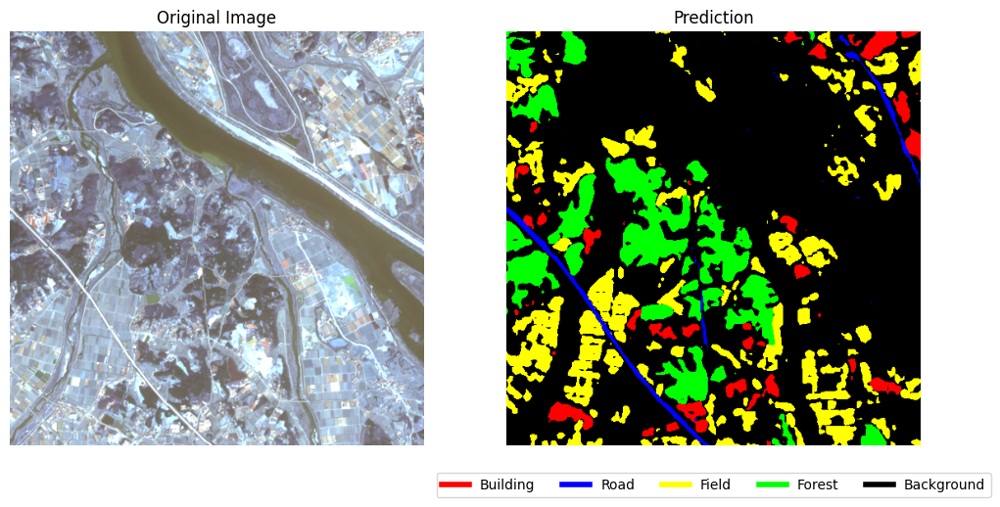

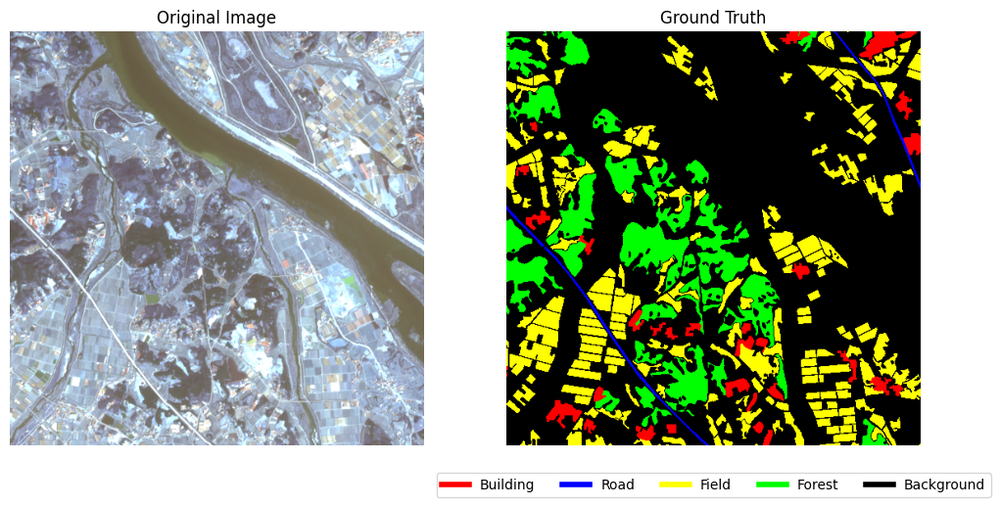

Processing: LC_SN_37711_036.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 2943 / 262144 (1.12%)
Class Building: IoU=0.4329, Precision=0.5393, Recall=0.6869, F1-Score=0.6042
Class Road: IoU=0.4524, Precision=0.5482, Recall=0.7213, F1-Score=0.6229
Class Field: IoU=0.5079, Precision=0.7763, Recall=0.5951, F1-Score=0.6737
Class Forest: IoU=0.7731, Precision=0.8524, Recall=0.8926, F1-Score=0.8720
Class Background: IoU=0.7067, Precision=0.8178, Recall=0.8388, F1-Score=0.8281

Overall Metrics: Mean IoU=0.5746, Pixel Accuracy=0.8041
Mean IoU: 0.5746, Pixel Accuracy: 0.8041


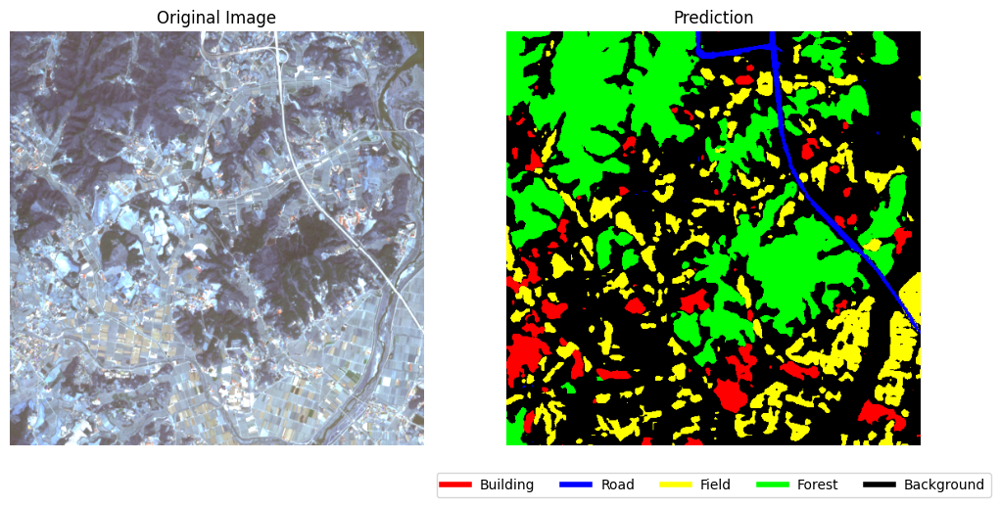

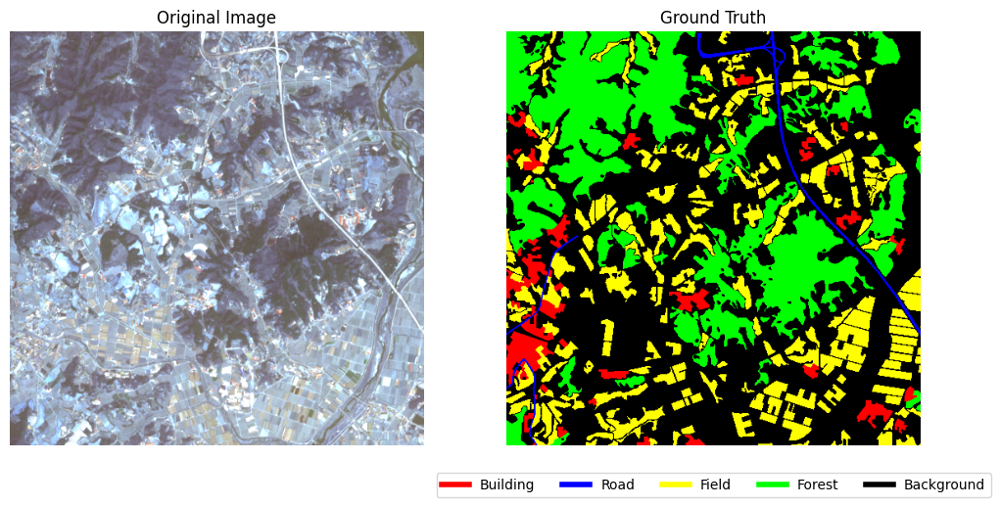

Processing: LC_SN_37711_037.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 3064 / 262144 (1.17%)
Class Building: IoU=0.2923, Precision=0.4154, Recall=0.4966, F1-Score=0.4524
Class Road: IoU=0.3882, Precision=0.4891, Recall=0.6529, F1-Score=0.5593
Class Field: IoU=0.2023, Precision=0.3211, Recall=0.3536, F1-Score=0.3366
Class Forest: IoU=0.9120, Precision=0.9419, Recall=0.9663, F1-Score=0.9540
Class Background: IoU=0.6591, Precision=0.8379, Recall=0.7555, F1-Score=0.7946

Overall Metrics: Mean IoU=0.4908, Pixel Accuracy=0.9019
Mean IoU: 0.4908, Pixel Accuracy: 0.9019


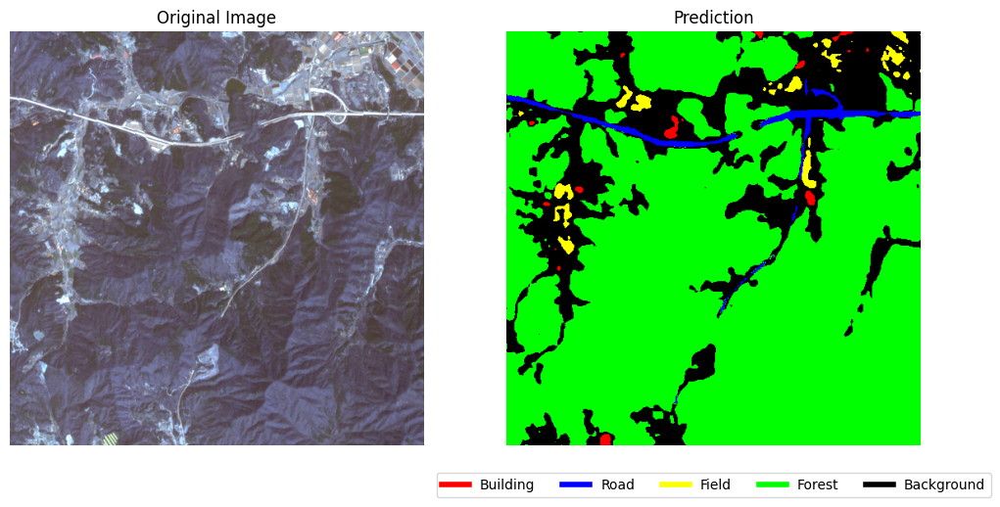

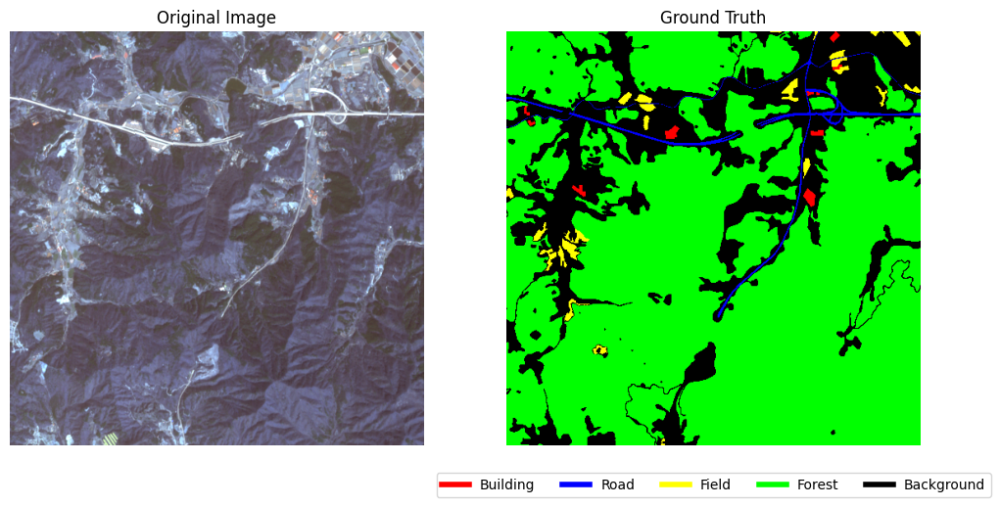

Processing: LC_SN_37711_039.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 2389 / 262144 (0.91%)
Class Building: IoU=0.3394, Precision=0.4318, Recall=0.6134, F1-Score=0.5068
Class Road: IoU=0.4760, Precision=0.4981, Recall=0.9147, F1-Score=0.6450
Class Field: IoU=0.4211, Precision=0.7597, Recall=0.4858, F1-Score=0.5927
Class Forest: IoU=0.8484, Precision=0.9262, Recall=0.9100, F1-Score=0.9180
Class Background: IoU=0.6832, Precision=0.7812, Recall=0.8448, F1-Score=0.8118

Overall Metrics: Mean IoU=0.5536, Pixel Accuracy=0.8504
Mean IoU: 0.5536, Pixel Accuracy: 0.8504


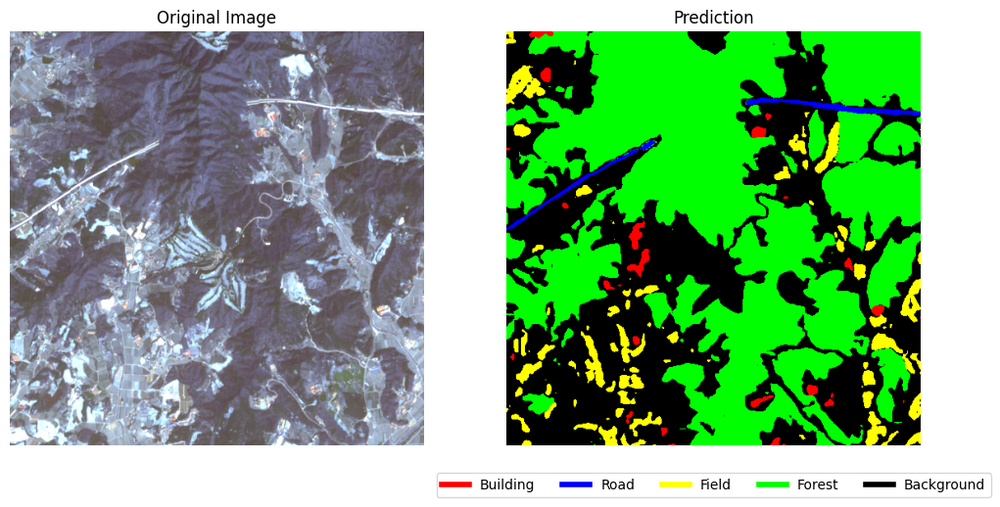

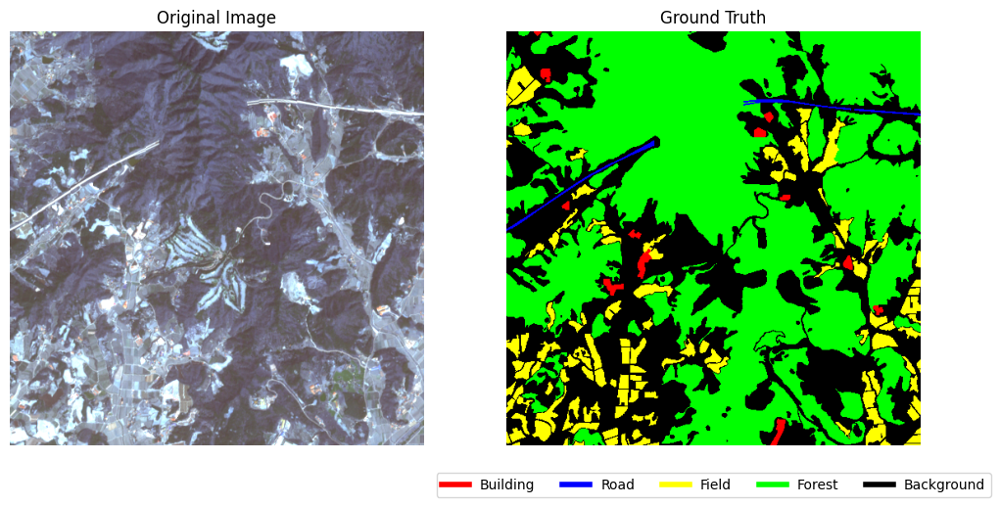

Processing: LC_SN_37711_040.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 3735 / 262144 (1.42%)
Class Building: IoU=0.4509, Precision=0.5518, Recall=0.7115, F1-Score=0.6215
Class Road: IoU=0.4480, Precision=0.4964, Recall=0.8214, F1-Score=0.6188
Class Field: IoU=0.5022, Precision=0.8083, Recall=0.5701, F1-Score=0.6686
Class Forest: IoU=0.7791, Precision=0.8757, Recall=0.8760, F1-Score=0.8758
Class Background: IoU=0.6879, Precision=0.7867, Recall=0.8457, F1-Score=0.8151

Overall Metrics: Mean IoU=0.5736, Pixel Accuracy=0.8062
Mean IoU: 0.5736, Pixel Accuracy: 0.8062


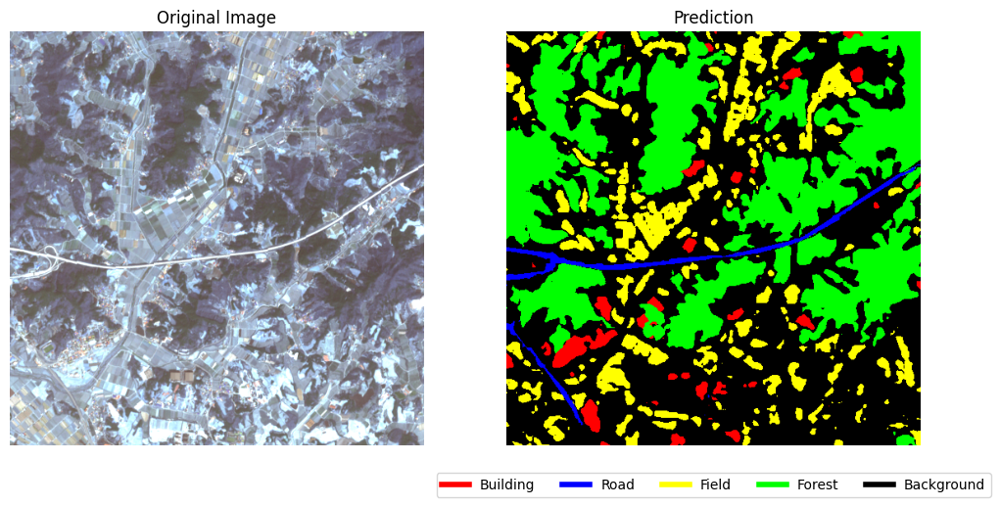

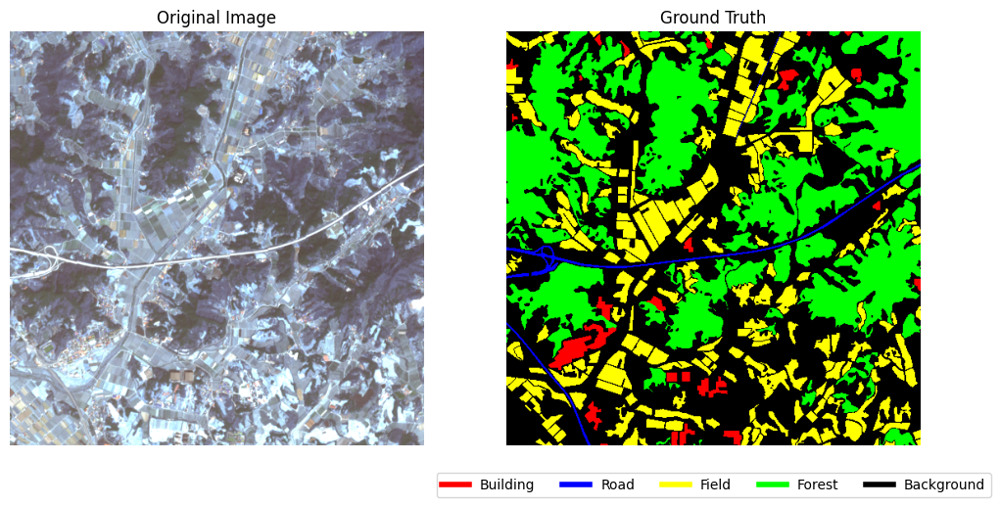

Processing: LC_SN_37711_041.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 3390 / 262144 (1.29%)
Class Building: IoU=0.5320, Precision=0.6920, Recall=0.6971, F1-Score=0.6946
Class Road: IoU=0.3759, Precision=0.5061, Recall=0.5939, F1-Score=0.5465
Class Field: IoU=0.4935, Precision=0.7630, Recall=0.5829, F1-Score=0.6609
Class Forest: IoU=0.7522, Precision=0.8903, Recall=0.8290, F1-Score=0.8586
Class Background: IoU=0.8211, Precision=0.8810, Recall=0.9235, F1-Score=0.9017

Overall Metrics: Mean IoU=0.5950, Pixel Accuracy=0.8647
Mean IoU: 0.5950, Pixel Accuracy: 0.8647


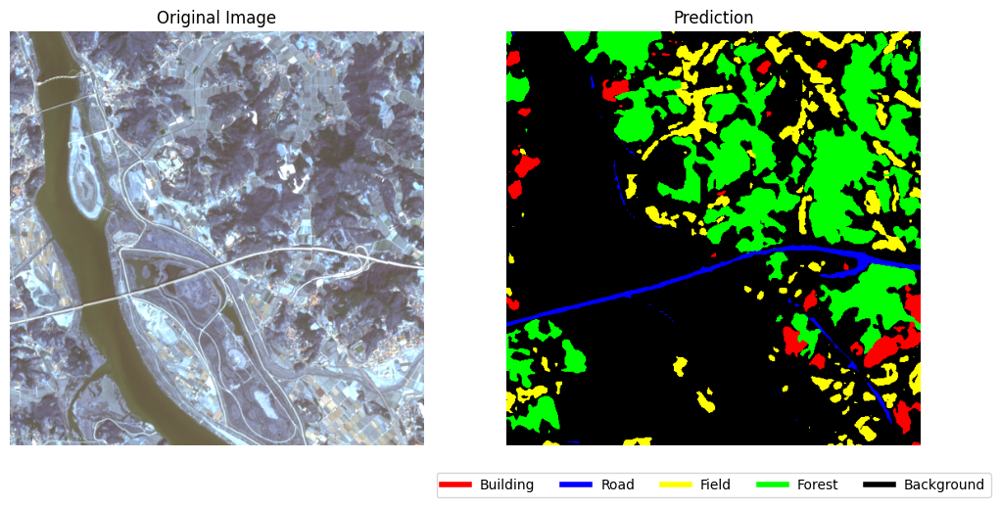

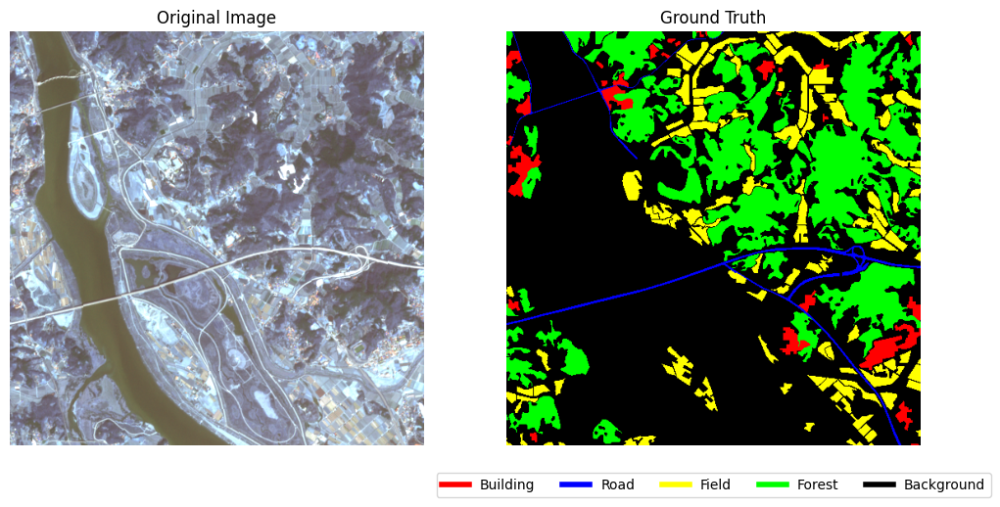

Processing: LC_SN_37711_042.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 5960 / 262144 (2.27%)
Class Building: IoU=0.4613, Precision=0.6260, Recall=0.6368, F1-Score=0.6313
Class Road: IoU=0.4057, Precision=0.4516, Recall=0.7996, F1-Score=0.5772
Class Field: IoU=0.3900, Precision=0.7428, Recall=0.4509, F1-Score=0.5611
Class Forest: IoU=0.8036, Precision=0.8844, Recall=0.8979, F1-Score=0.8911
Class Background: IoU=0.7623, Precision=0.8666, Recall=0.8636, F1-Score=0.8651

Overall Metrics: Mean IoU=0.5646, Pixel Accuracy=0.8537
Mean IoU: 0.5646, Pixel Accuracy: 0.8537


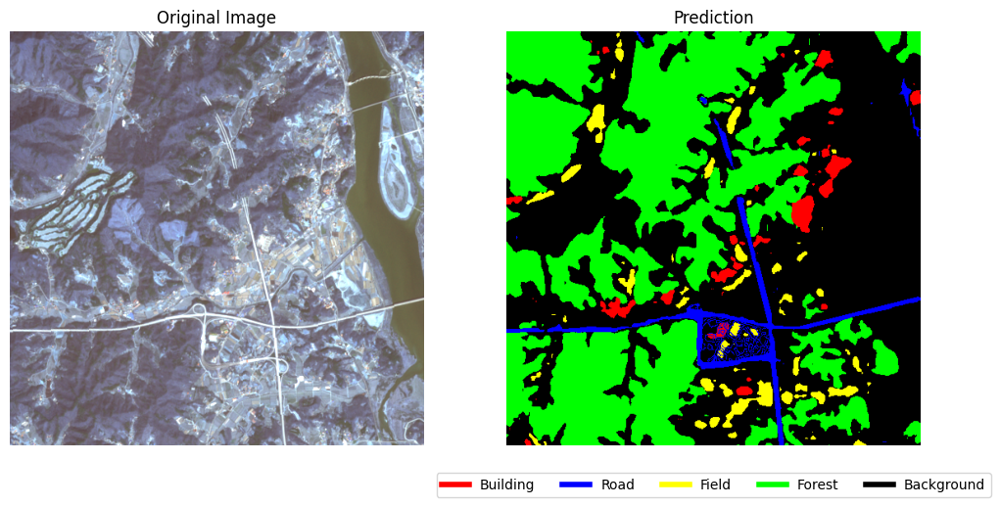

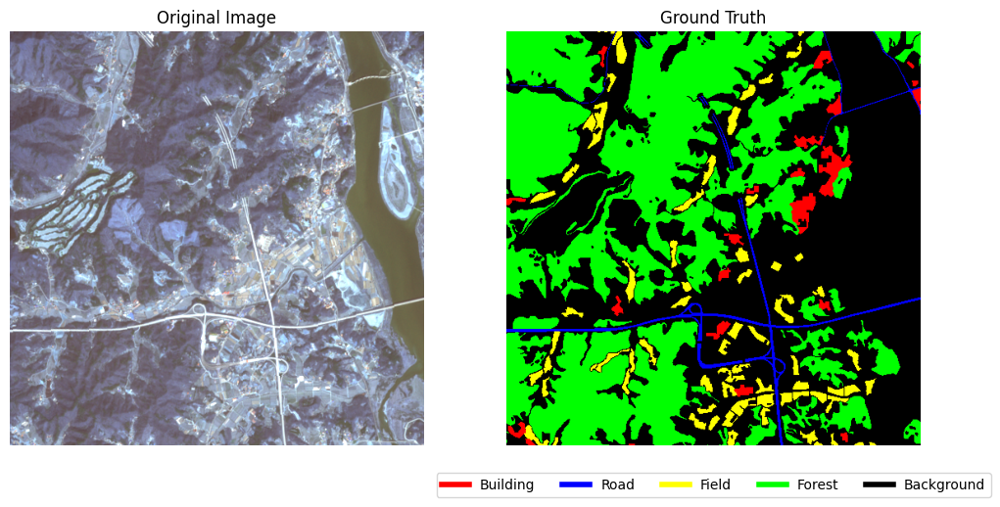

Processing: LC_SN_37713_016.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 8750 / 262144 (3.34%)
Class Building: IoU=0.6124, Precision=0.8095, Recall=0.7154, F1-Score=0.7596
Class Road: IoU=0.3727, Precision=0.4366, Recall=0.7181, F1-Score=0.5430
Class Field: IoU=0.6661, Precision=0.7841, Recall=0.8158, F1-Score=0.7996
Class Forest: IoU=0.7057, Precision=0.8641, Recall=0.7937, F1-Score=0.8275
Class Background: IoU=0.6867, Precision=0.8135, Recall=0.8150, F1-Score=0.8142

Overall Metrics: Mean IoU=0.6087, Pixel Accuracy=0.7933
Mean IoU: 0.6087, Pixel Accuracy: 0.7933


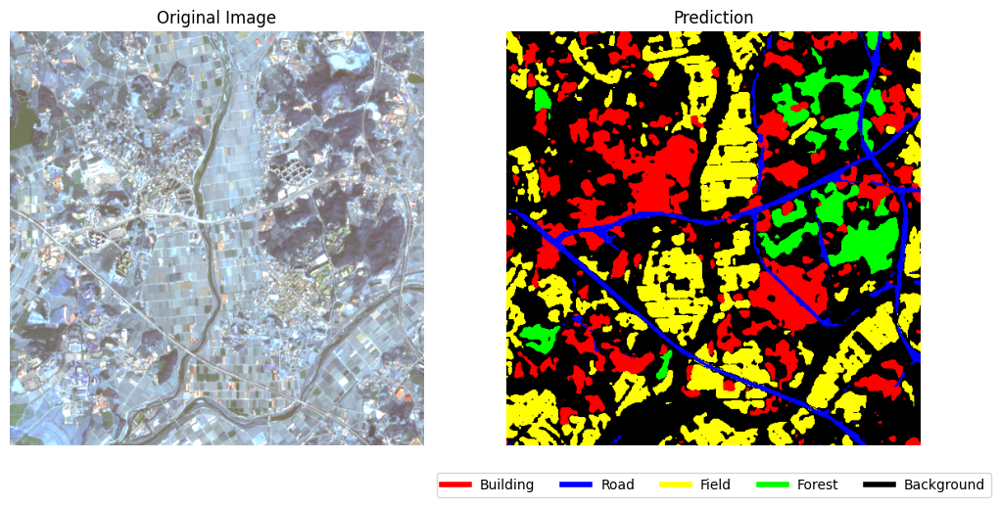

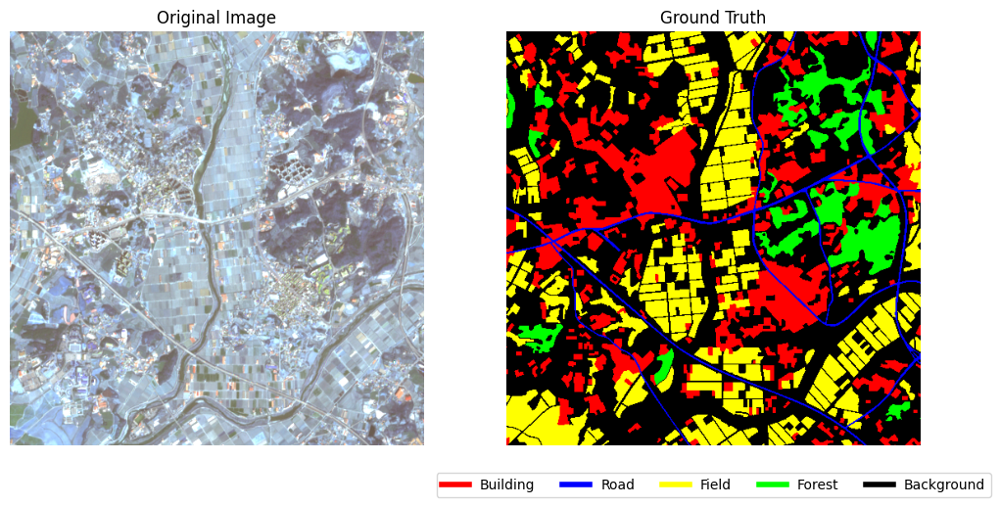

Processing: LC_SN_37713_017.tif


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)
Changed Pixels: 6245 / 262144 (2.38%)
Class Building: IoU=0.6297, Precision=0.8114, Recall=0.7377, F1-Score=0.7728
Class Road: IoU=0.5067, Precision=0.5350, Recall=0.9056, F1-Score=0.6726
Class Field: IoU=0.5617, Precision=0.7448, Recall=0.6957, F1-Score=0.7194
Class Forest: IoU=0.7374, Precision=0.8723, Recall=0.8265, F1-Score=0.8488
Class Background: IoU=0.6453, Precision=0.7697, Recall=0.7997, F1-Score=0.7844

Overall Metrics: Mean IoU=0.6162, Pixel Accuracy=0.7722
Mean IoU: 0.6162, Pixel Accuracy: 0.7722


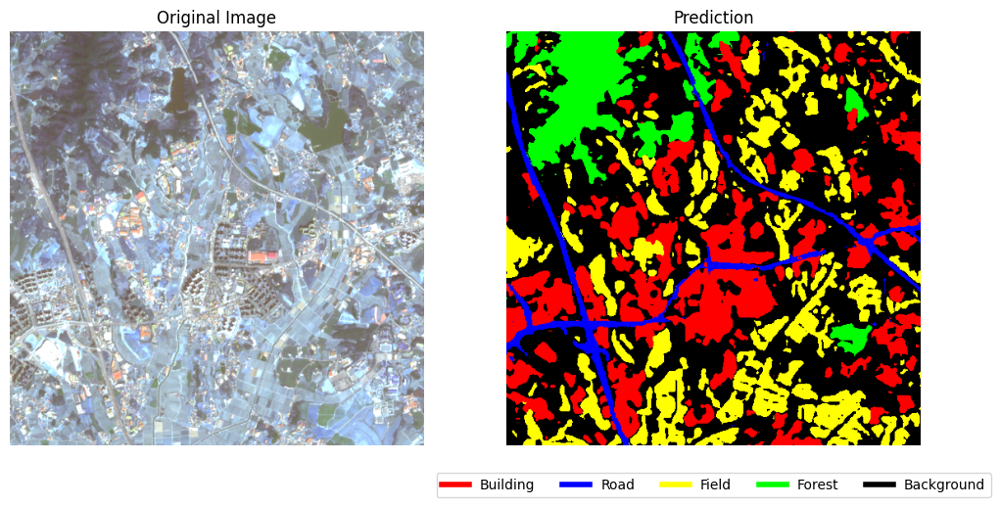

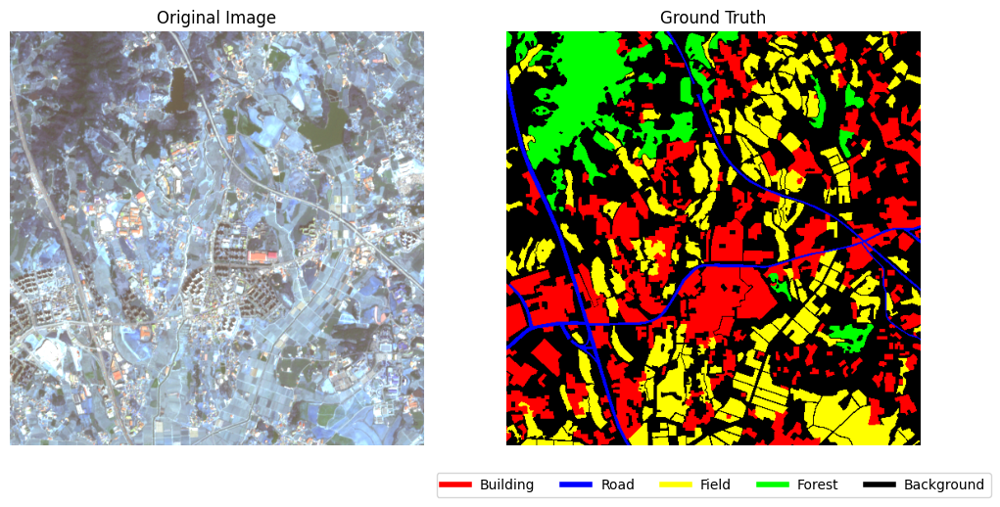

Processing: LC_SN_37713_019.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 20873 / 262144 (7.96%)
Class Building: IoU=0.7533, Precision=0.8821, Recall=0.8377, F1-Score=0.8593
Class Road: IoU=0.2776, Precision=0.2868, Recall=0.8970, F1-Score=0.4346
Class Field: IoU=0.7393, Precision=0.8413, Recall=0.8591, F1-Score=0.8501
Class Forest: IoU=0.5415, Precision=0.9602, Recall=0.5539, F1-Score=0.7026
Class Background: IoU=0.6726, Precision=0.8619, Recall=0.7539, F1-Score=0.8043

Overall Metrics: Mean IoU=0.5969, Pixel Accuracy=0.8020
Mean IoU: 0.5969, Pixel Accuracy: 0.8020


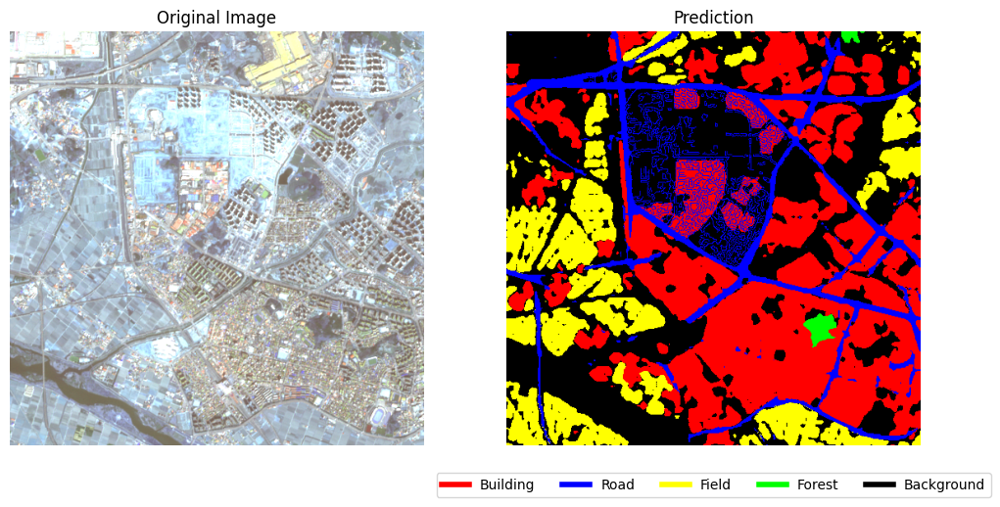

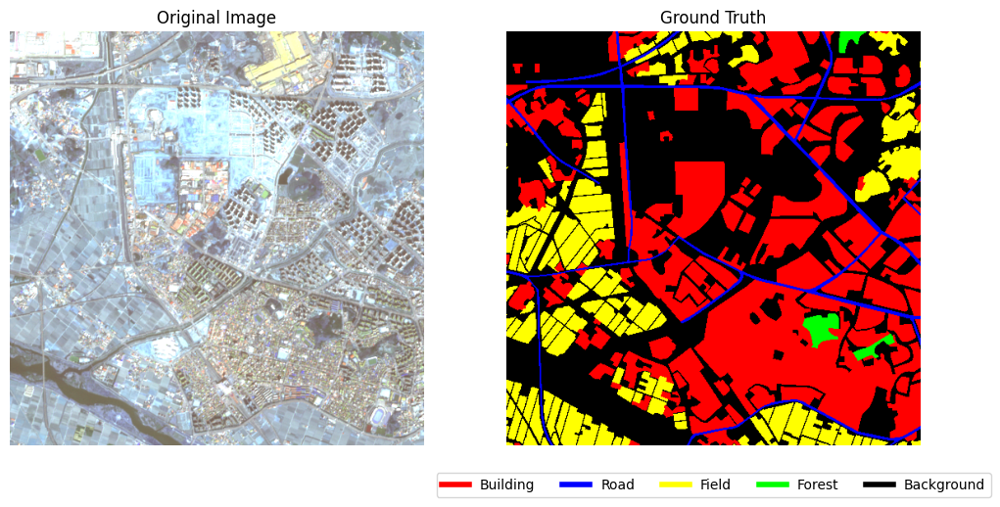

Processing: LC_SN_37713_020.tif


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)
Changed Pixels: 10864 / 262144 (4.14%)
Class Building: IoU=0.6053, Precision=0.7748, Recall=0.7345, F1-Score=0.7541
Class Road: IoU=0.3394, Precision=0.3625, Recall=0.8422, F1-Score=0.5068
Class Field: IoU=0.7725, Precision=0.8624, Recall=0.8811, F1-Score=0.8716
Class Forest: IoU=0.0000, Precision=0.0000, Recall=0.0000, F1-Score=0.0000
Class Background: IoU=0.7446, Precision=0.8792, Recall=0.8294, F1-Score=0.8536

Overall Metrics: Mean IoU=0.4923, Pixel Accuracy=0.8370
Mean IoU: 0.4923, Pixel Accuracy: 0.8370


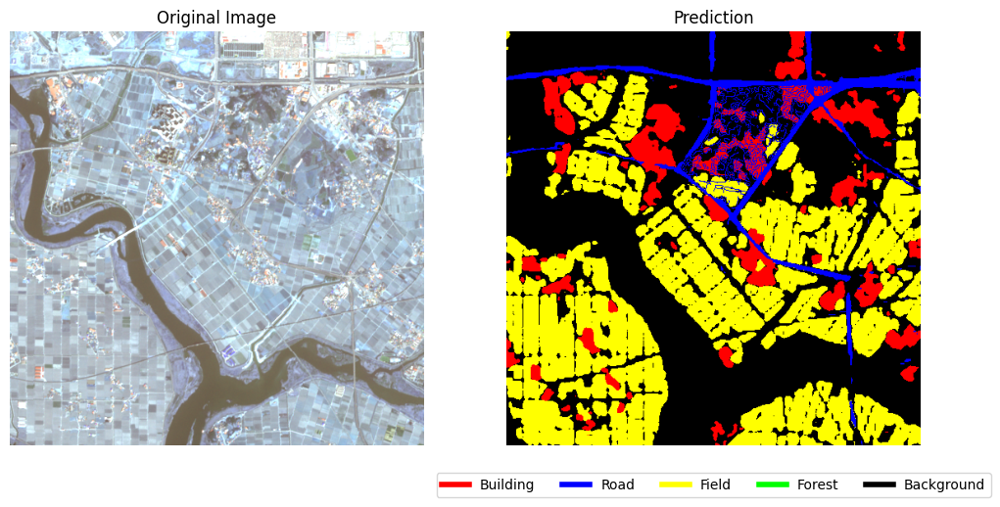

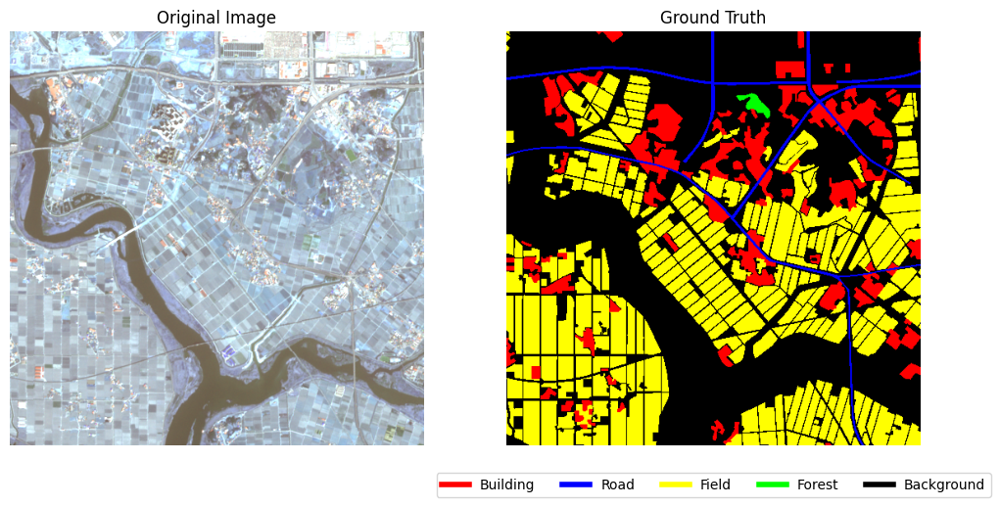

Processing: LC_SN_37713_021.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 4206 / 262144 (1.60%)
Class Building: IoU=0.5940, Precision=0.8142, Recall=0.6871, F1-Score=0.7453
Class Road: IoU=0.3463, Precision=0.4488, Recall=0.6026, F1-Score=0.5145
Class Field: IoU=0.6601, Precision=0.7969, Recall=0.7936, F1-Score=0.7952
Class Forest: IoU=0.7392, Precision=0.8564, Recall=0.8437, F1-Score=0.8500
Class Background: IoU=0.6912, Precision=0.8005, Recall=0.8351, F1-Score=0.8174

Overall Metrics: Mean IoU=0.6061, Pixel Accuracy=0.8046
Mean IoU: 0.6061, Pixel Accuracy: 0.8046


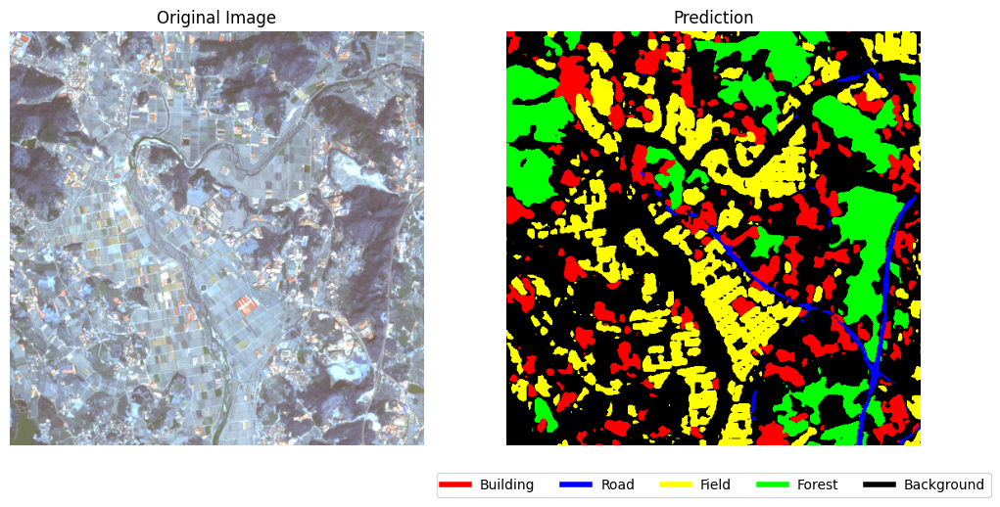

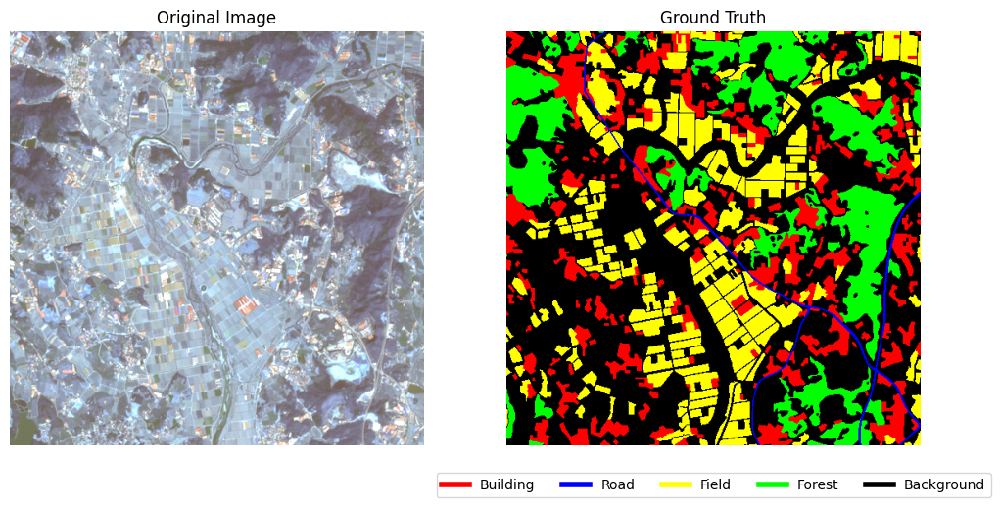

Processing: LC_SN_37713_022.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 4602 / 262144 (1.76%)
Class Building: IoU=0.5603, Precision=0.7972, Recall=0.6534, F1-Score=0.7182
Class Road: IoU=0.5002, Precision=0.5418, Recall=0.8671, F1-Score=0.6669
Class Field: IoU=0.4666, Precision=0.6825, Recall=0.5960, F1-Score=0.6363
Class Forest: IoU=0.8212, Precision=0.8889, Recall=0.9152, F1-Score=0.9018
Class Background: IoU=0.6733, Precision=0.7972, Recall=0.8124, F1-Score=0.8047

Overall Metrics: Mean IoU=0.6043, Pixel Accuracy=0.8168
Mean IoU: 0.6043, Pixel Accuracy: 0.8168


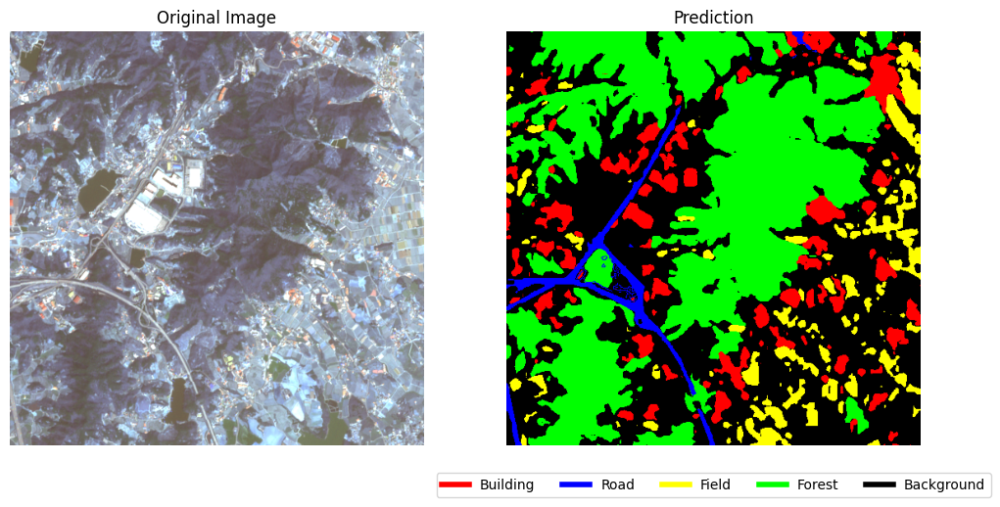

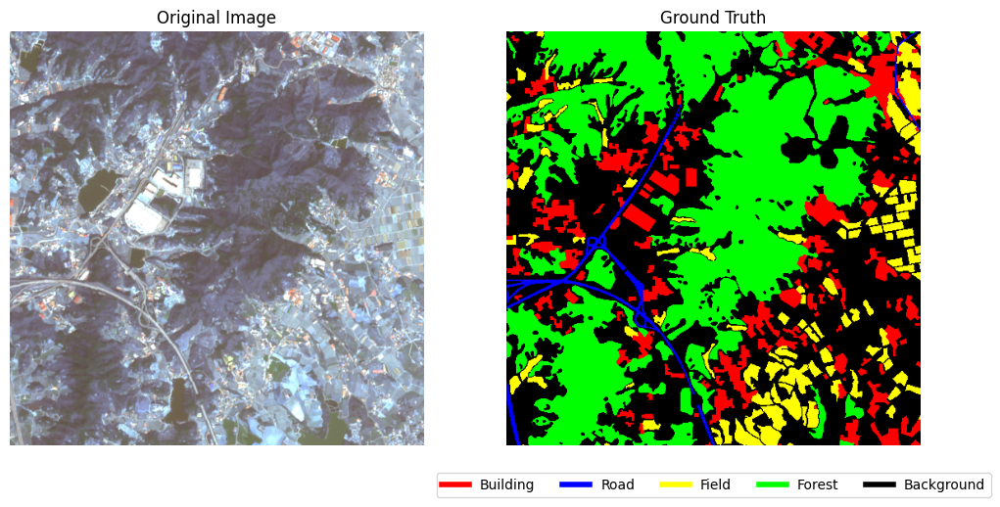

Processing: LC_SN_37713_023.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 9726 / 262144 (3.71%)
Class Building: IoU=0.6026, Precision=0.8008, Recall=0.7089, F1-Score=0.7520
Class Road: IoU=0.5287, Precision=0.5504, Recall=0.9306, F1-Score=0.6917
Class Field: IoU=0.4450, Precision=0.6867, Recall=0.5583, F1-Score=0.6159
Class Forest: IoU=0.7879, Precision=0.8660, Recall=0.8973, F1-Score=0.8813
Class Background: IoU=0.6847, Precision=0.8182, Recall=0.8076, F1-Score=0.8129

Overall Metrics: Mean IoU=0.6098, Pixel Accuracy=0.8036
Mean IoU: 0.6098, Pixel Accuracy: 0.8036


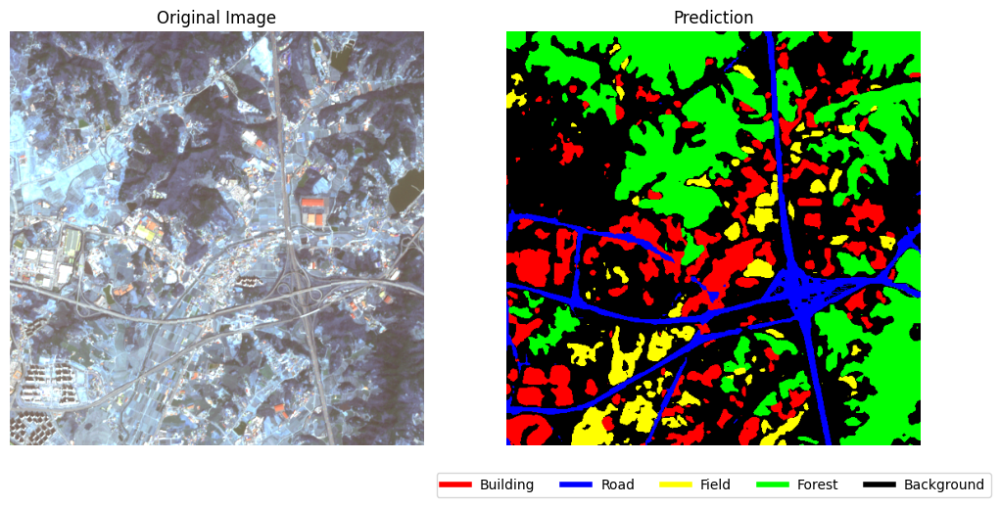

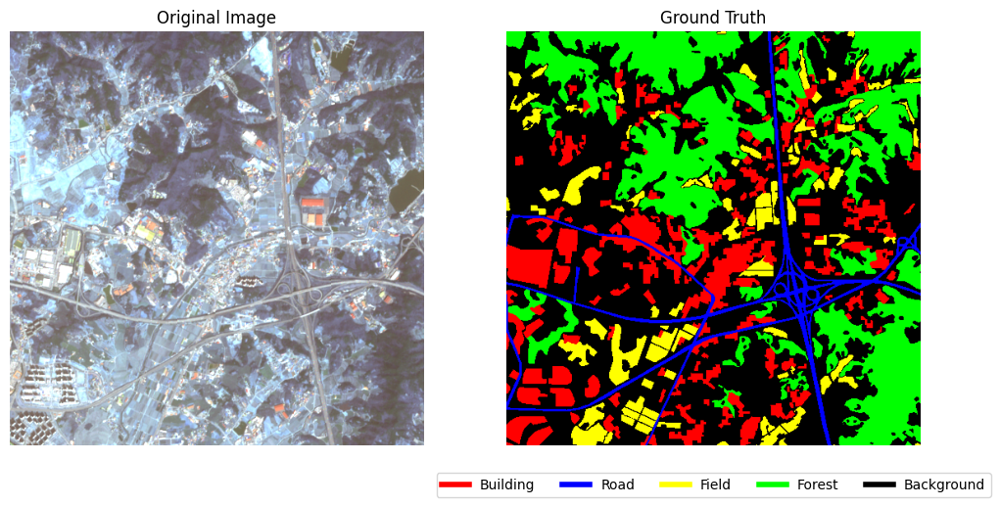

Processing: LC_SN_37713_024.tif


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)
Changed Pixels: 16678 / 262144 (6.36%)
Class Building: IoU=0.6945, Precision=0.8443, Recall=0.7966, F1-Score=0.8197
Class Road: IoU=0.2899, Precision=0.2955, Recall=0.9394, F1-Score=0.4495
Class Field: IoU=0.5400, Precision=0.7599, Recall=0.6510, F1-Score=0.7013
Class Forest: IoU=0.6594, Precision=0.7950, Recall=0.7945, F1-Score=0.7948
Class Background: IoU=0.7228, Precision=0.8657, Recall=0.8140, F1-Score=0.8391

Overall Metrics: Mean IoU=0.5813, Pixel Accuracy=0.7982
Mean IoU: 0.5813, Pixel Accuracy: 0.7982


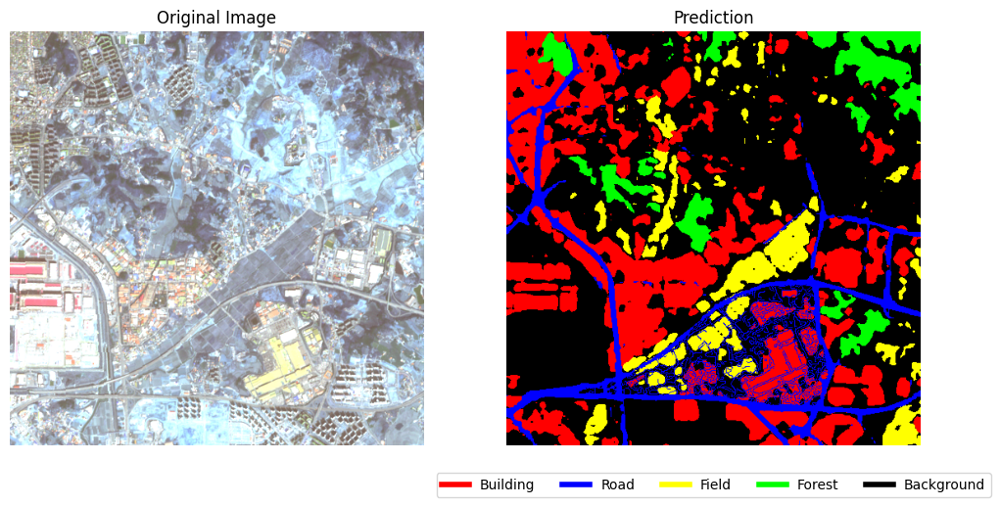

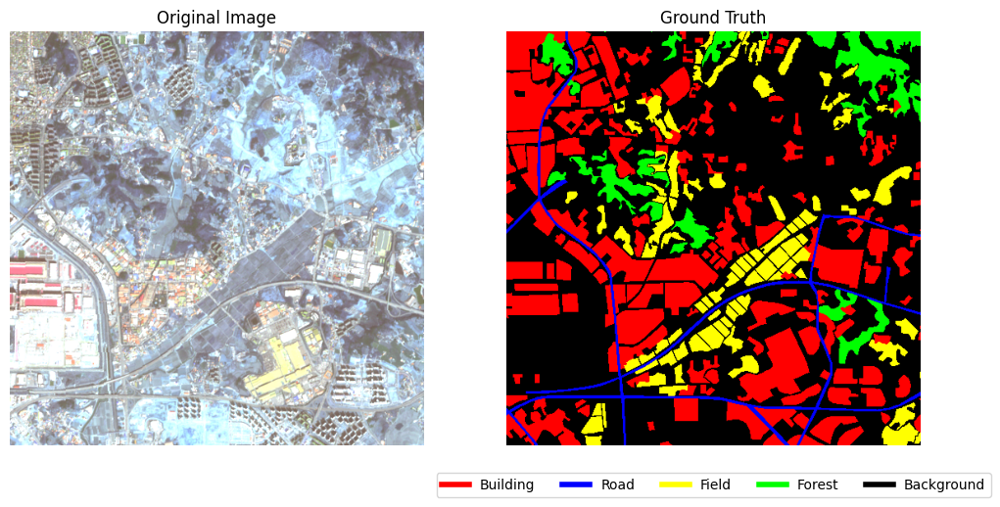

Processing: LC_SN_37713_025.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 20604 / 262144 (7.86%)
Class Building: IoU=0.6752, Precision=0.8114, Recall=0.8008, F1-Score=0.8061
Class Road: IoU=0.2972, Precision=0.3023, Recall=0.9467, F1-Score=0.4583
Class Field: IoU=0.5658, Precision=0.6660, Recall=0.7901, F1-Score=0.7227
Class Forest: IoU=0.3754, Precision=0.8884, Recall=0.3939, F1-Score=0.5458
Class Background: IoU=0.7786, Precision=0.9218, Recall=0.8336, F1-Score=0.8755

Overall Metrics: Mean IoU=0.5384, Pixel Accuracy=0.8181
Mean IoU: 0.5384, Pixel Accuracy: 0.8181


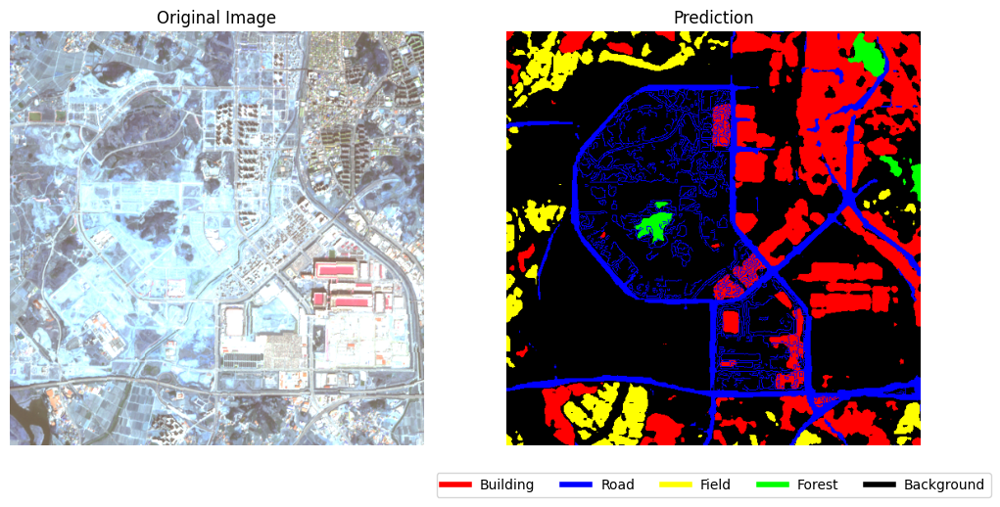

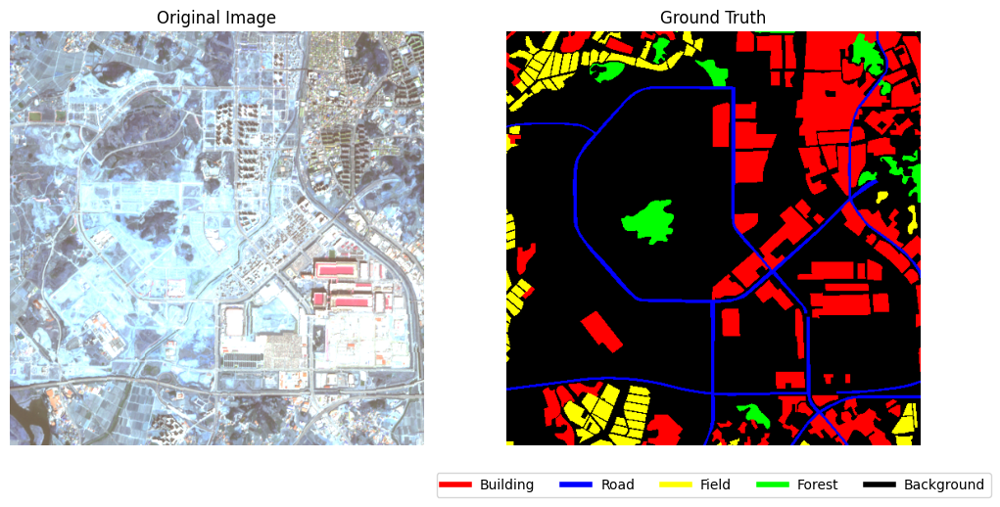

Processing: LC_SN_37713_026.tif


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)
Changed Pixels: 3522 / 262144 (1.34%)
Class Building: IoU=0.5212, Precision=0.8018, Recall=0.5983, F1-Score=0.6852
Class Road: IoU=0.3402, Precision=0.4504, Recall=0.5816, F1-Score=0.5077
Class Field: IoU=0.5976, Precision=0.8187, Recall=0.6887, F1-Score=0.7481
Class Forest: IoU=0.8300, Precision=0.8874, Recall=0.9277, F1-Score=0.9071
Class Background: IoU=0.6409, Precision=0.7672, Recall=0.7955, F1-Score=0.7811

Overall Metrics: Mean IoU=0.5860, Pixel Accuracy=0.8237
Mean IoU: 0.5860, Pixel Accuracy: 0.8237


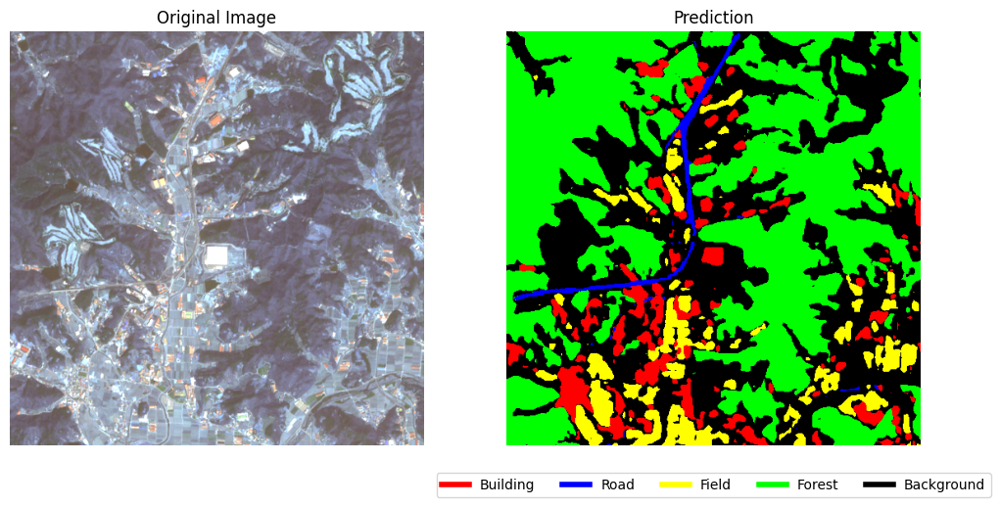

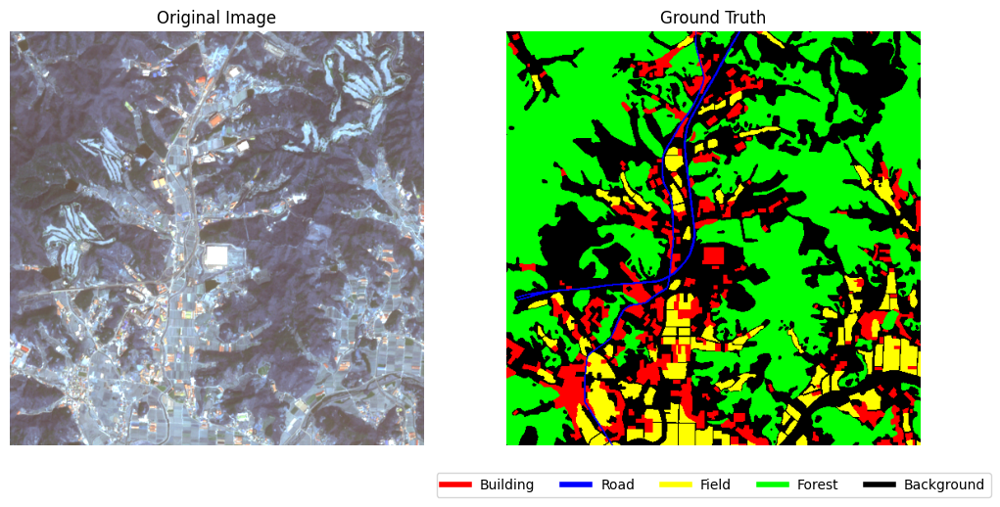

Processing: LC_SN_37713_027.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 2123 / 262144 (0.81%)
Class Building: IoU=0.6012, Precision=0.8065, Recall=0.7025, F1-Score=0.7509
Class Road: IoU=0.2880, Precision=0.4002, Recall=0.5067, F1-Score=0.4472
Class Field: IoU=0.5396, Precision=0.7817, Recall=0.6353, F1-Score=0.7009
Class Forest: IoU=0.8898, Precision=0.9286, Recall=0.9551, F1-Score=0.9417
Class Background: IoU=0.6311, Precision=0.7708, Recall=0.7769, F1-Score=0.7739

Overall Metrics: Mean IoU=0.5899, Pixel Accuracy=0.8667
Mean IoU: 0.5899, Pixel Accuracy: 0.8667


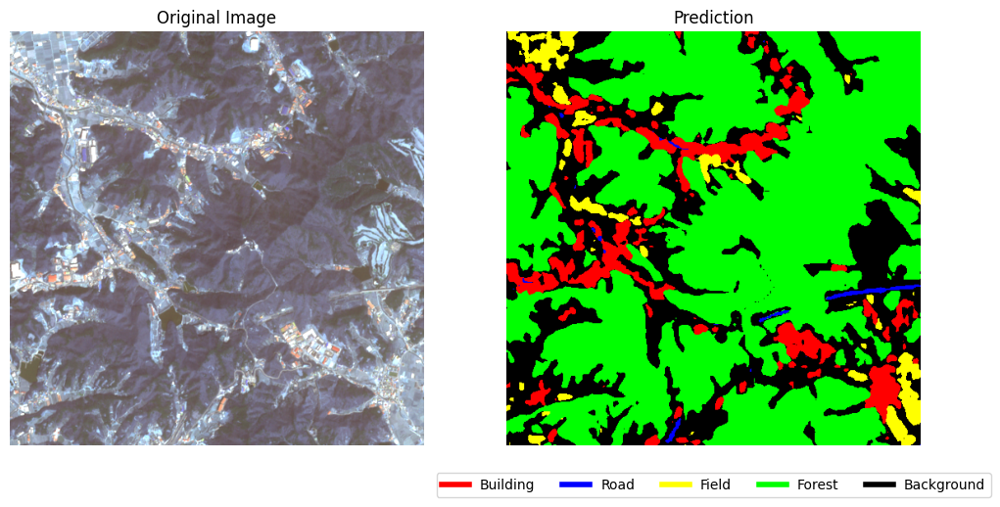

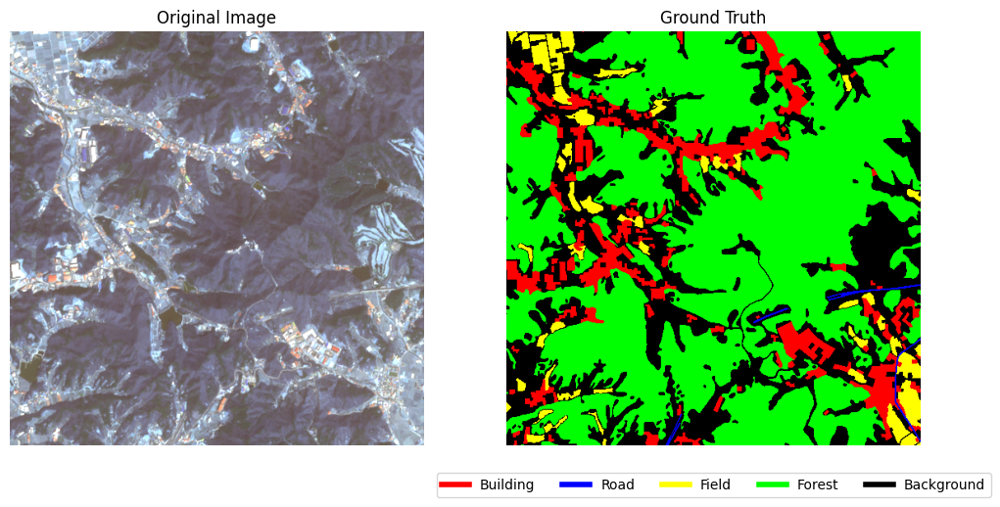

Processing: LC_SN_37713_028.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 3331 / 262144 (1.27%)
Class Building: IoU=0.5819, Precision=0.7626, Recall=0.7107, F1-Score=0.7357
Class Road: IoU=0.5627, Precision=0.5652, Recall=0.9922, F1-Score=0.7202
Class Field: IoU=0.5435, Precision=0.8141, Recall=0.6205, F1-Score=0.7042
Class Forest: IoU=0.8436, Precision=0.9107, Recall=0.9197, F1-Score=0.9152
Class Background: IoU=0.6490, Precision=0.7666, Recall=0.8089, F1-Score=0.7872

Overall Metrics: Mean IoU=0.6362, Pixel Accuracy=0.8292
Mean IoU: 0.6362, Pixel Accuracy: 0.8292


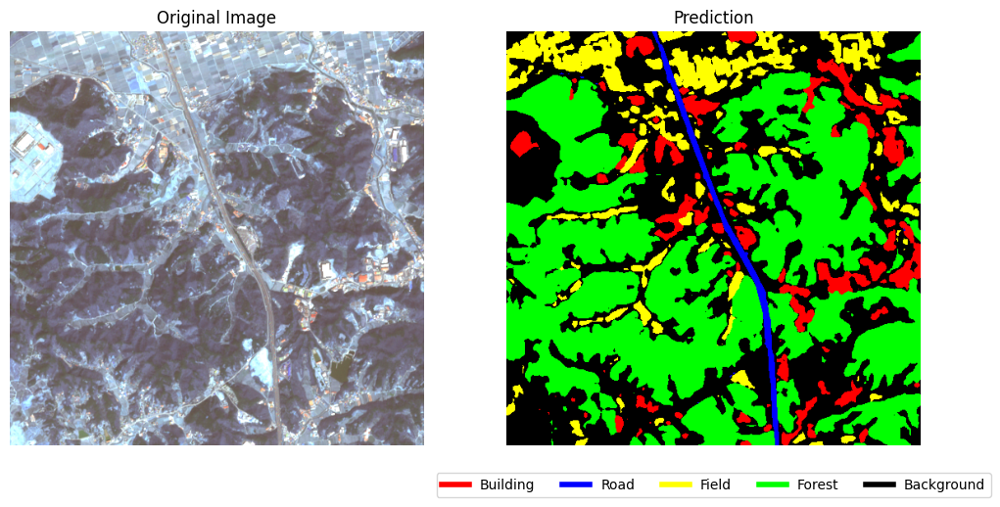

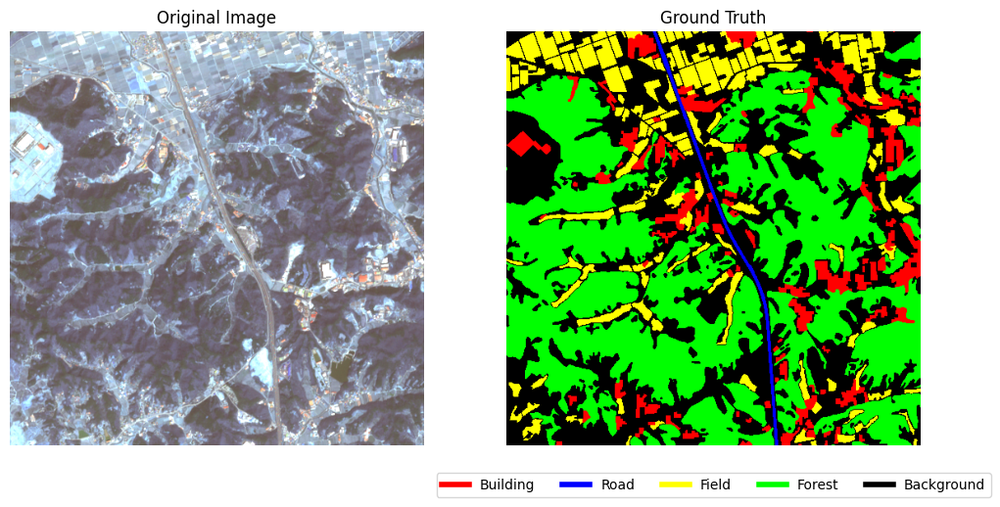

Processing: LC_SN_37713_029.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 6463 / 262144 (2.47%)
Class Building: IoU=0.6750, Precision=0.8389, Recall=0.7755, F1-Score=0.8059
Class Road: IoU=0.1785, Precision=0.1817, Recall=0.9106, F1-Score=0.3030
Class Field: IoU=0.5977, Precision=0.7898, Recall=0.7108, F1-Score=0.7482
Class Forest: IoU=0.8230, Precision=0.8899, Recall=0.9162, F1-Score=0.9029
Class Background: IoU=0.6942, Precision=0.8251, Recall=0.8140, F1-Score=0.8195

Overall Metrics: Mean IoU=0.5937, Pixel Accuracy=0.8233
Mean IoU: 0.5937, Pixel Accuracy: 0.8233


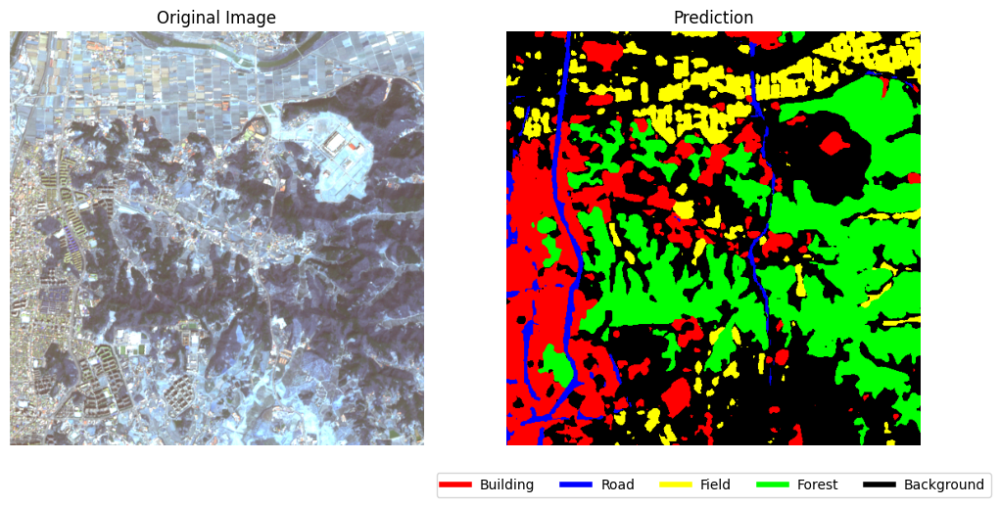

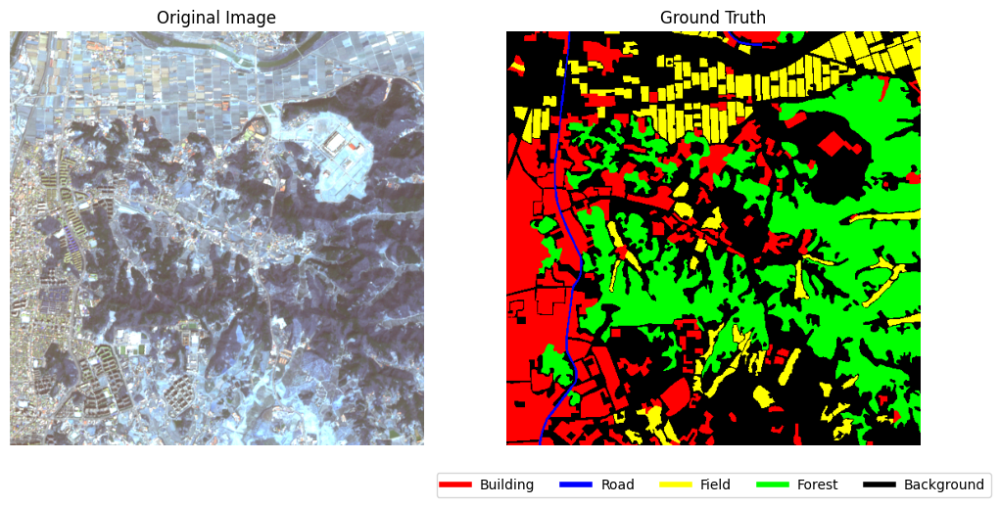

Processing: LC_SN_37713_030.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 5820 / 262144 (2.22%)
Class Building: IoU=0.7561, Precision=0.8610, Recall=0.8612, F1-Score=0.8611
Class Road: IoU=0.2969, Precision=0.3061, Recall=0.9085, F1-Score=0.4579
Class Field: IoU=0.6239, Precision=0.7717, Recall=0.7651, F1-Score=0.7684
Class Forest: IoU=0.4875, Precision=0.7959, Recall=0.5571, F1-Score=0.6554
Class Background: IoU=0.8073, Precision=0.8981, Recall=0.8888, F1-Score=0.8934

Overall Metrics: Mean IoU=0.5943, Pixel Accuracy=0.8598
Mean IoU: 0.5943, Pixel Accuracy: 0.8598


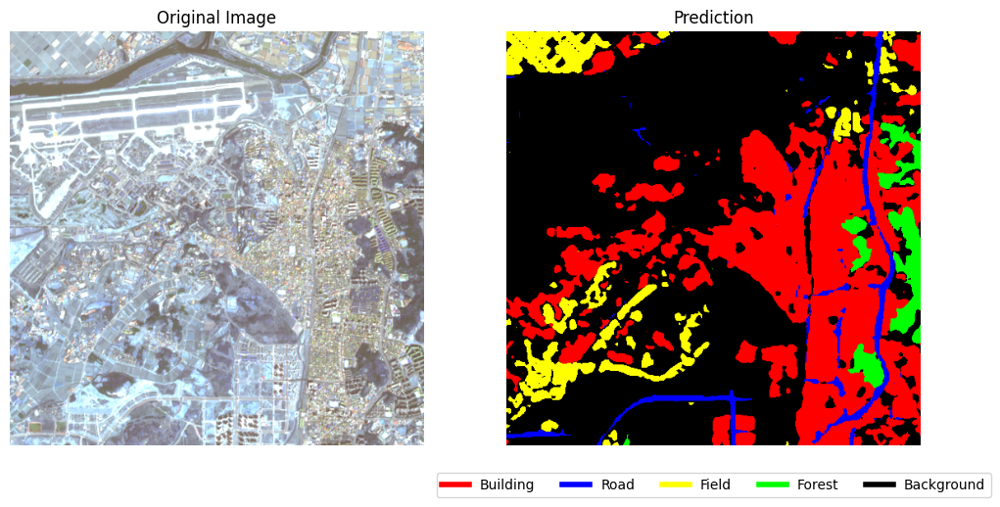

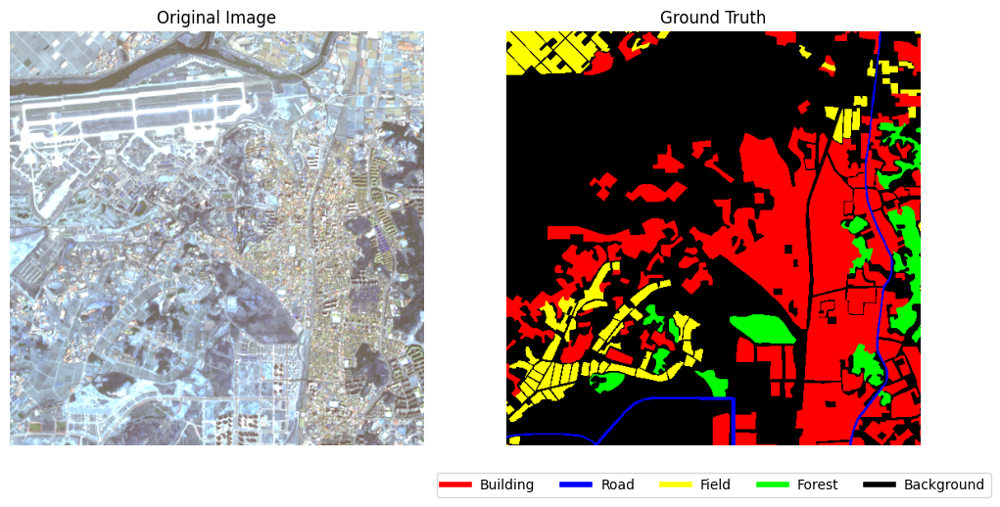

Processing: LC_SN_37713_031.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 9616 / 262144 (3.67%)
Class Building: IoU=0.6223, Precision=0.8213, Recall=0.7198, F1-Score=0.7672
Class Road: IoU=0.3402, Precision=0.3859, Recall=0.7418, F1-Score=0.5077
Class Field: IoU=0.6802, Precision=0.8075, Recall=0.8119, F1-Score=0.8097
Class Forest: IoU=0.8504, Precision=0.9112, Recall=0.9273, F1-Score=0.9192
Class Background: IoU=0.6722, Precision=0.8087, Recall=0.7993, F1-Score=0.8040

Overall Metrics: Mean IoU=0.6331, Pixel Accuracy=0.8119
Mean IoU: 0.6331, Pixel Accuracy: 0.8119


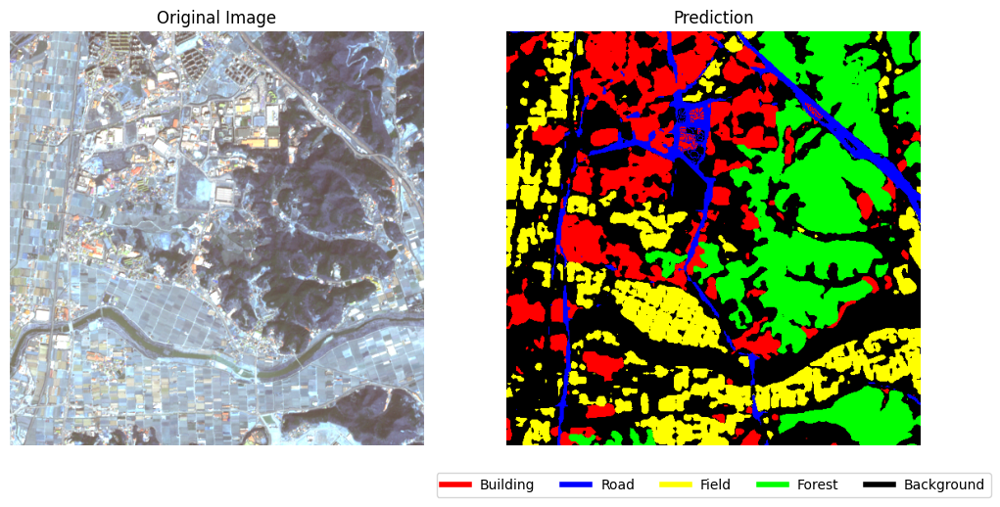

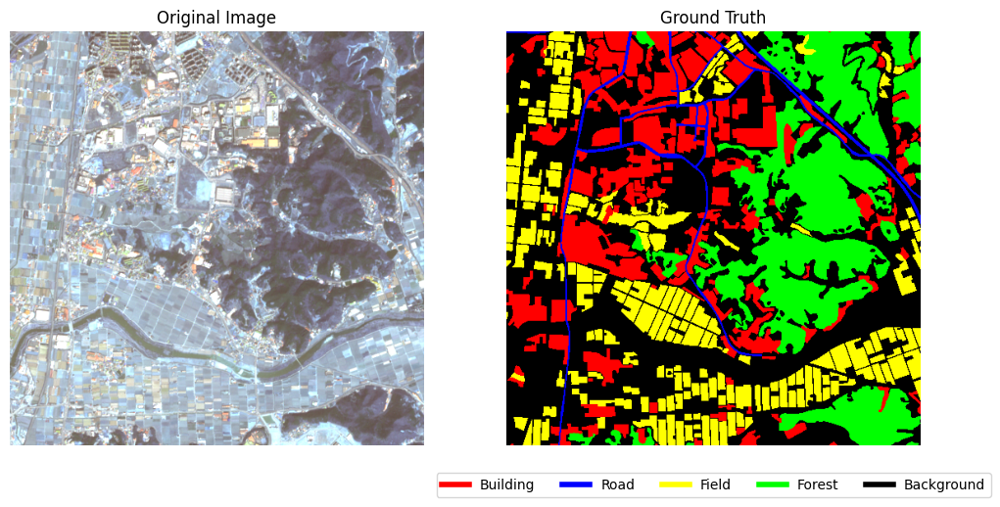

Processing: LC_SN_37713_032.tif


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)
Changed Pixels: 4389 / 262144 (1.67%)
Class Building: IoU=0.7232, Precision=0.8381, Recall=0.8406, F1-Score=0.8394
Class Road: IoU=0.3162, Precision=0.3934, Recall=0.6170, F1-Score=0.4805
Class Field: IoU=0.6860, Precision=0.8238, Recall=0.8040, F1-Score=0.8138
Class Forest: IoU=0.3714, Precision=0.8042, Recall=0.4083, F1-Score=0.5416
Class Background: IoU=0.7694, Precision=0.8627, Recall=0.8769, F1-Score=0.8697

Overall Metrics: Mean IoU=0.5732, Pixel Accuracy=0.8432
Mean IoU: 0.5732, Pixel Accuracy: 0.8432


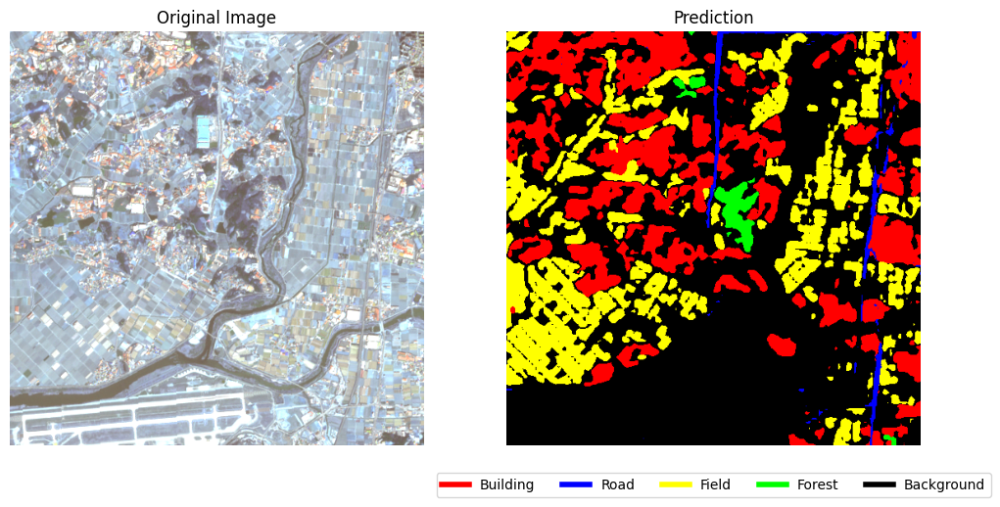

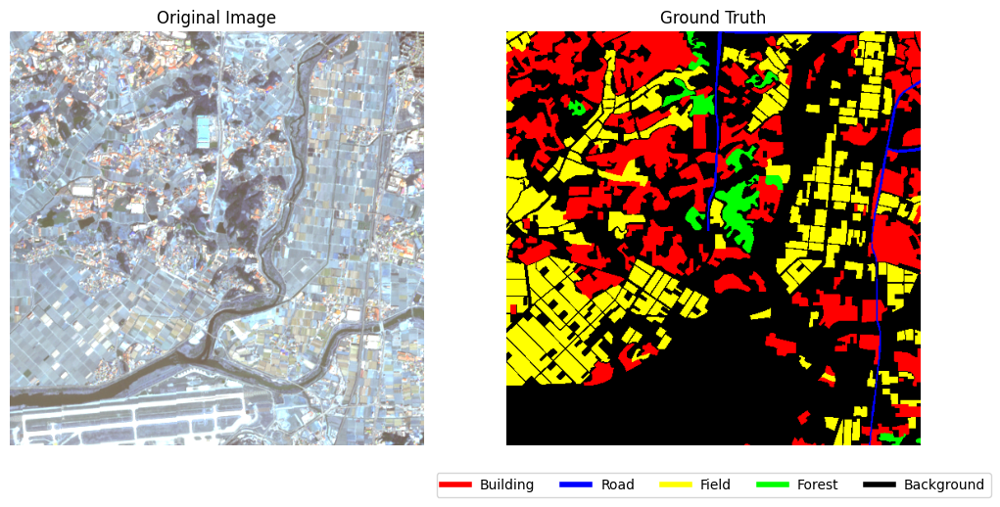

Processing: LC_SN_37713_034.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 8512 / 262144 (3.25%)
Class Building: IoU=0.7305, Precision=0.8456, Recall=0.8429, F1-Score=0.8443
Class Road: IoU=0.3354, Precision=0.3676, Recall=0.7930, F1-Score=0.5023
Class Field: IoU=0.6154, Precision=0.7750, Recall=0.7492, F1-Score=0.7619
Class Forest: IoU=0.7229, Precision=0.8372, Recall=0.8412, F1-Score=0.8392
Class Background: IoU=0.7006, Precision=0.8379, Recall=0.8104, F1-Score=0.8239

Overall Metrics: Mean IoU=0.6210, Pixel Accuracy=0.8176
Mean IoU: 0.6210, Pixel Accuracy: 0.8176


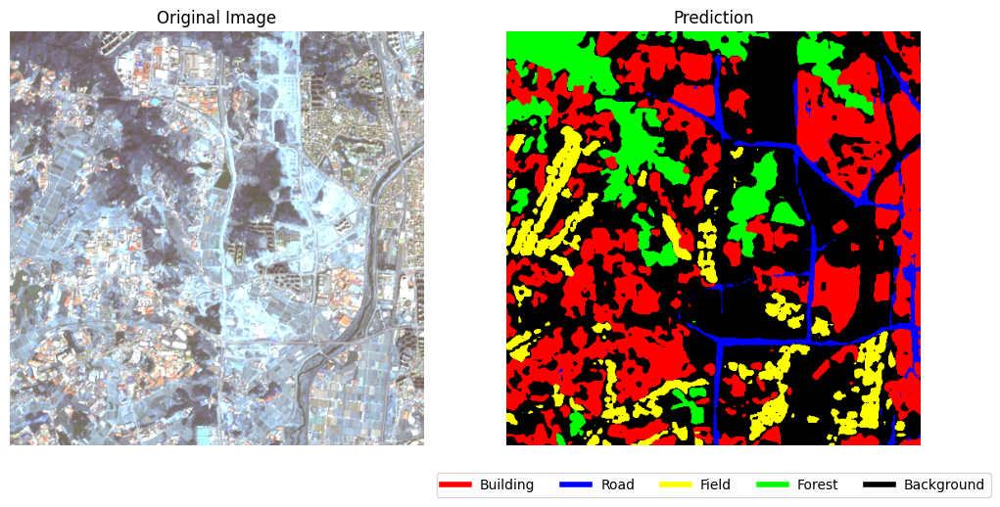

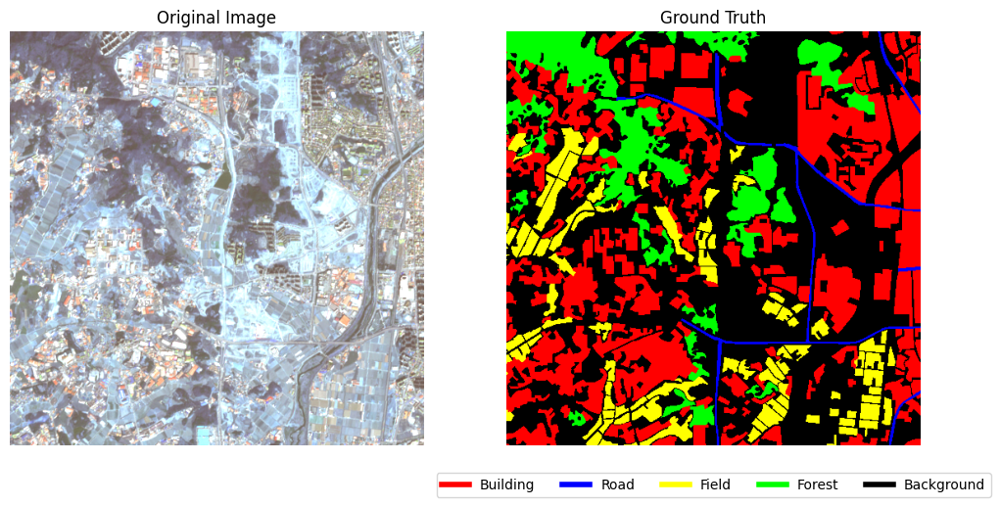

Processing: LC_SN_37713_036.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 26216 / 262144 (10.00%)
Class Building: IoU=0.6670, Precision=0.8471, Recall=0.7583, F1-Score=0.8003
Class Road: IoU=0.3001, Precision=0.3171, Recall=0.8484, F1-Score=0.4616
Class Field: IoU=0.6312, Precision=0.8165, Recall=0.7356, F1-Score=0.7739
Class Forest: IoU=0.8050, Precision=0.8800, Recall=0.9042, F1-Score=0.8920
Class Background: IoU=0.6185, Precision=0.8218, Recall=0.7143, F1-Score=0.7643

Overall Metrics: Mean IoU=0.6044, Pixel Accuracy=0.7702
Mean IoU: 0.6044, Pixel Accuracy: 0.7702


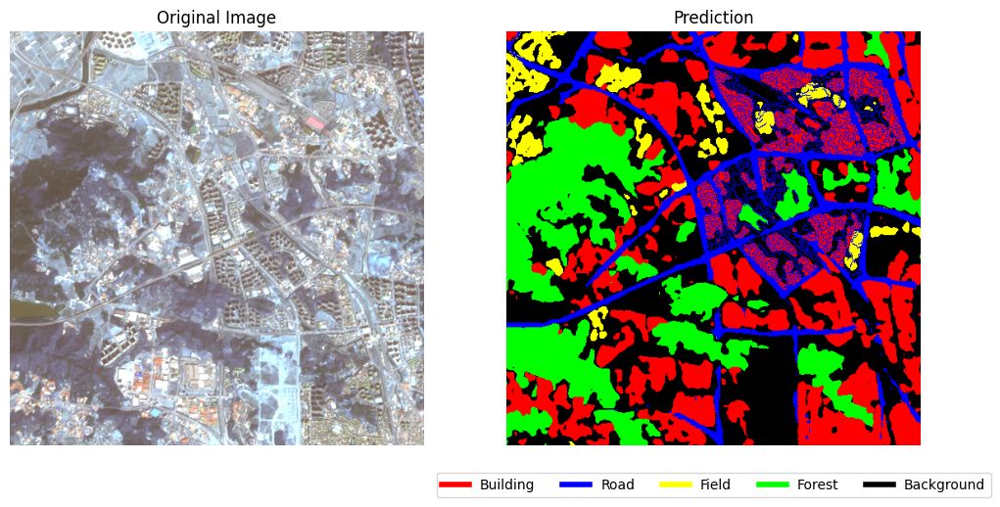

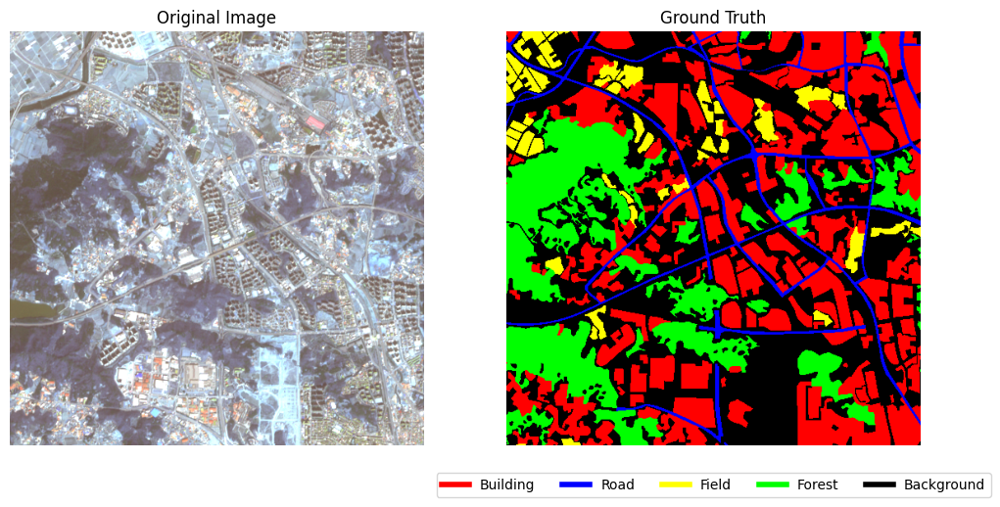

Processing: LC_SN_37714_024.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 24056 / 262144 (9.18%)
Class Building: IoU=0.5907, Precision=0.8190, Recall=0.6793, F1-Score=0.7427
Class Road: IoU=0.2475, Precision=0.2652, Recall=0.7877, F1-Score=0.3968
Class Field: IoU=0.6277, Precision=0.7892, Recall=0.7541, F1-Score=0.7712
Class Forest: IoU=0.7703, Precision=0.8444, Recall=0.8977, F1-Score=0.8702
Class Background: IoU=0.6502, Precision=0.8259, Recall=0.7535, F1-Score=0.7881

Overall Metrics: Mean IoU=0.5773, Pixel Accuracy=0.7602
Mean IoU: 0.5773, Pixel Accuracy: 0.7602


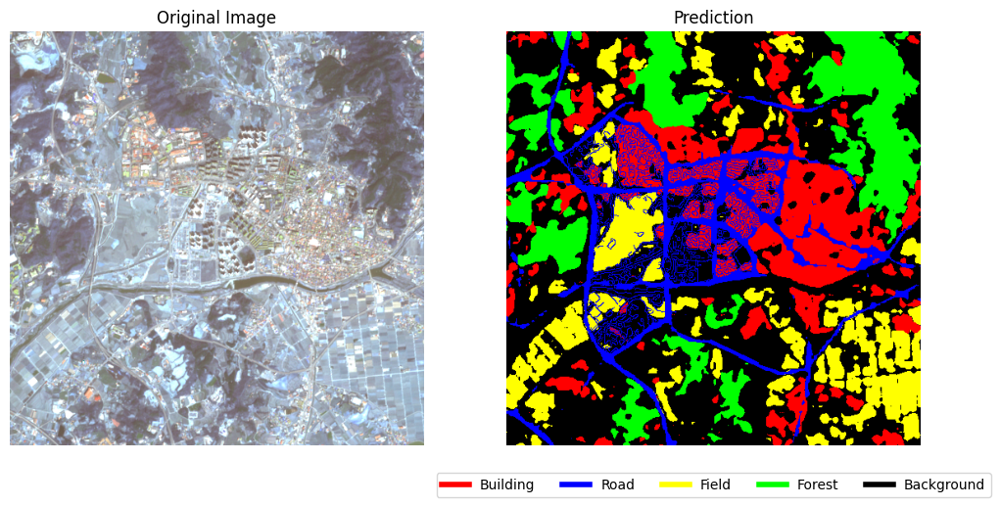

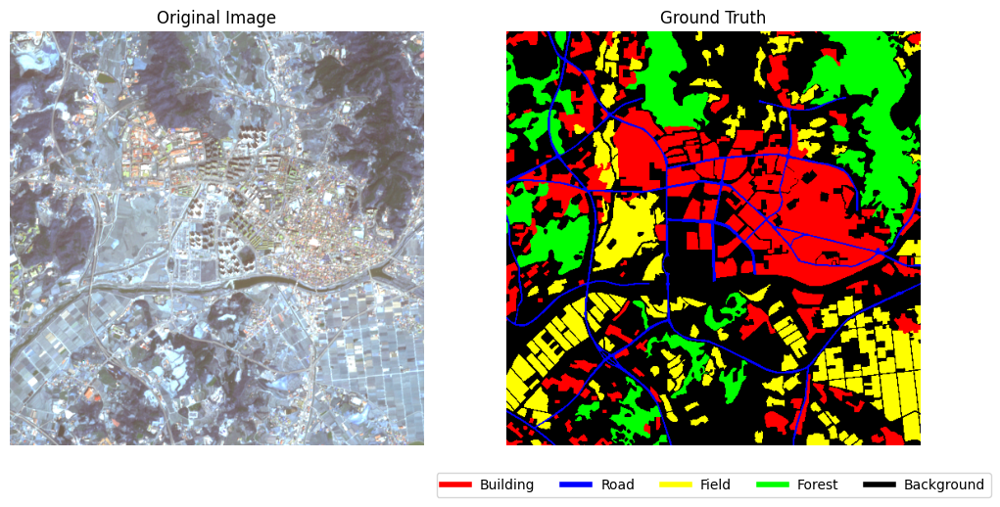

Processing: LC_SN_37714_025.tif


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)
Changed Pixels: 2544 / 262144 (0.97%)
Class Building: IoU=0.4977, Precision=0.7030, Recall=0.6301, F1-Score=0.6646
Class Road: IoU=0.5631, Precision=0.6024, Recall=0.8962, F1-Score=0.7205
Class Field: IoU=0.4291, Precision=0.7967, Recall=0.4819, F1-Score=0.6005
Class Forest: IoU=0.8345, Precision=0.8827, Recall=0.9386, F1-Score=0.9098
Class Background: IoU=0.6792, Precision=0.8226, Recall=0.7958, F1-Score=0.8090

Overall Metrics: Mean IoU=0.6007, Pixel Accuracy=0.8492
Mean IoU: 0.6007, Pixel Accuracy: 0.8492


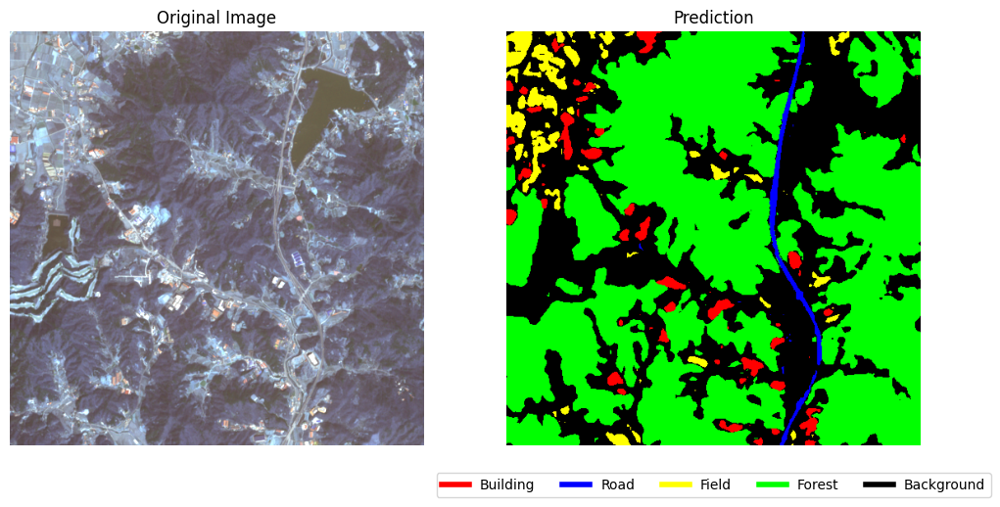

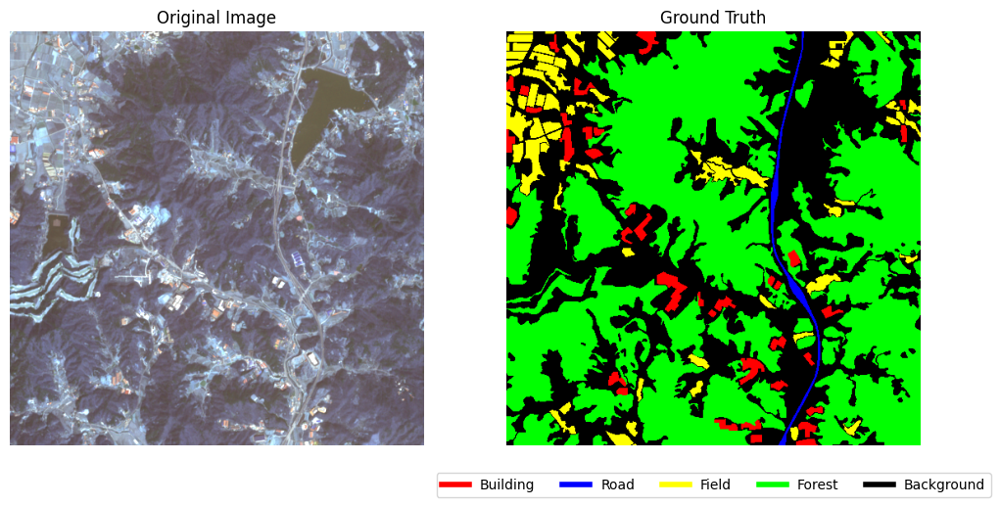

Processing: LC_SN_37714_029.tif
softmax_output shape: (1, 5, 512, 512)
prediction shape: (512, 512)


C:\Users\SIM2REAL\AppData\Local\Programs\Python\Python312\Lib\site-packages\rasterio\__init__.py:368: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  dataset = DatasetReader(path, driver=driver, sharing=sharing, **kwargs)


Changed Pixels: 3776 / 262144 (1.44%)
Class Building: IoU=0.5369, Precision=0.7211, Recall=0.6775, F1-Score=0.6986
Class Road: IoU=0.3786, Precision=0.4357, Recall=0.7430, F1-Score=0.5493
Class Field: IoU=0.5556, Precision=0.7406, Recall=0.6897, F1-Score=0.7143
Class Forest: IoU=0.8132, Precision=0.8744, Recall=0.9208, F1-Score=0.8970
Class Background: IoU=0.6882, Precision=0.8223, Recall=0.8083, F1-Score=0.8153

Overall Metrics: Mean IoU=0.5945, Pixel Accuracy=0.8138
Mean IoU: 0.5945, Pixel Accuracy: 0.8138


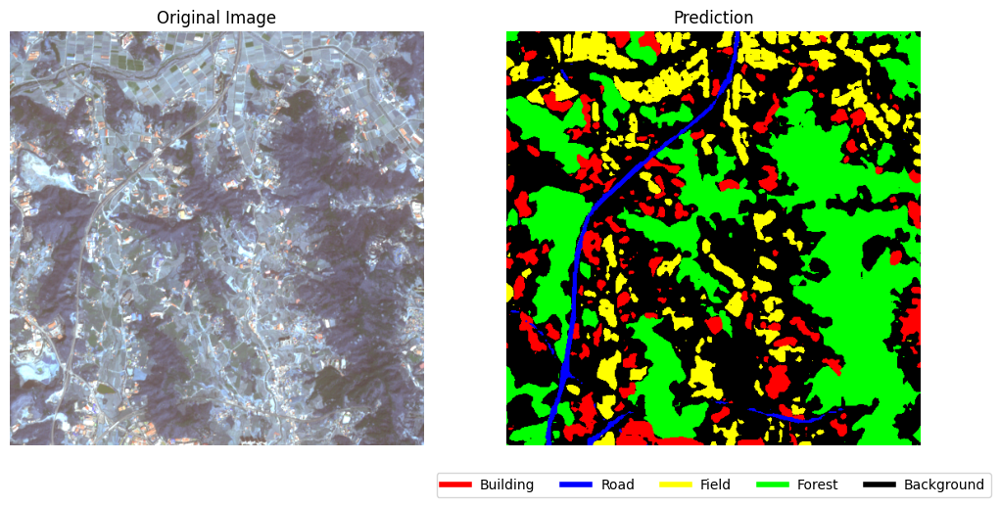

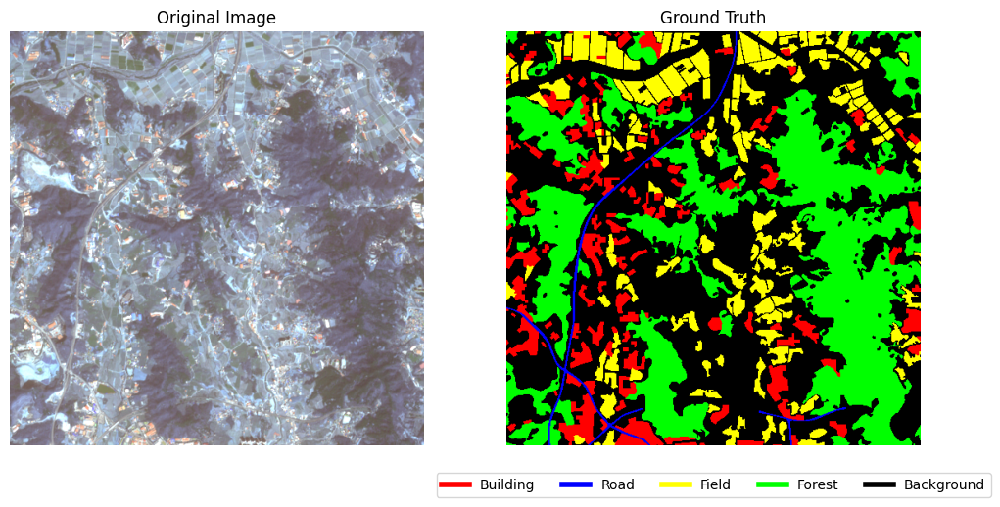


Final Evaluation Results:
Average Mean IoU: 0.5856
Average Pixel Accuracy: 0.8229
Class Building: Average IoU=0.7457, Precision=0.7457, Recall=0.7145, F1-Score=0.7266
Class Road: Average IoU=0.4245, Precision=0.4245, Recall=0.7982, F1-Score=0.5418
Class Field: Average IoU=0.7607, Precision=0.7607, Recall=0.6714, F1-Score=0.7087
Class Forest: Average IoU=0.8435, Precision=0.8435, Recall=0.7951, F1-Score=0.8106
Class Background: Average IoU=0.8289, Precision=0.8289, Recall=0.8186, F1-Score=0.8230


In [133]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

def main():
    weight_path = "weights/Segformer_weights(b3)/Segformer_epoch_50.pth"
    image_folder = "최종성능테스트/images"
    mask_folder = "최종성능테스트/labels"
    num_classes = 5
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model = load_trained_model(weight_path, num_classes, device)

    class_mapping = {
        10: 0,  # Building
        30: 1,  # Road
        50: 2,  # Field
        60: 2,  # Merge Field
        71: 3,  # Merge Forest
        75: 3,  # Merge Forest
        70: 3,  # Forest
        90: 2,  # Field (전라도)
        100: 4  # Background
    }
    class_names = ["Building", "Road", "Field", "Forest", "Background"]
    colormap = [
        (255, 0, 0),      # Building (Red)
        (0, 0, 255),      # Road (Blue)
        (255, 255, 0),    # Field (Yellow)
        (0, 255, 0),      # Forest (Green)
        (0, 0, 0)         # Background (Black)
    ]

    image_transform = transforms.Compose([
        transforms.Lambda(enhance_edges),  # 엣지 보강
        transforms.Lambda(enhance_saturation),  # 채도 강화
        transforms.Lambda(enhance_clahe),  # CLAHE 적용
        transforms.Resize((512, 512)),
        transforms.ToTensor(),
        transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
    ])

    image_files = sorted([f for f in os.listdir(image_folder) if f.endswith(".tif")])
    mask_files = sorted([f for f in os.listdir(mask_folder) if f.endswith(".tif")])

    ########################################
    all_iou = []
    all_pixel_acc = []
    all_precision = []
    all_recall = []
    all_f1 = []
    all_iou_classes = [[] for _ in range(num_classes)]
    all_precision_classes = [[] for _ in range(num_classes)]
    all_recall_classes = [[] for _ in range(num_classes)]
    all_f1_classes = [[] for _ in range(num_classes)]
    ########################################


    for image_file, mask_file in zip(image_files, mask_files):
        image_path = os.path.join(image_folder, image_file)
        mask_path = os.path.join(mask_folder, mask_file)
        print(f"Processing: {image_file}")

        with rasterio.open(image_path) as src:
            image = src.read([1, 2, 3])
            image = np.transpose(image, (1, 2, 0))

        with rasterio.open(mask_path) as src:
            mask = src.read(1)

        ###############################정규화 전처리#########################################
        if image.max() > 255:
            image = np.log1p(image)
            image = ((image - image.min()) / (image.max() - image.min()) * 255).astype(np.uint8)
        else:
            image = image.astype(np.uint8)
        ######################################################################################

        # ✅ 1. 모델 예측 먼저 수행
        input_image = preprocess_image(image, image_transform).to(device)
        mapped_mask = preprocess_mask(mask, class_mapping).cpu().long()

        with torch.no_grad():
            output = model(input_image)
            softmax_output = torch.nn.functional.softmax(output, dim=1).cpu().numpy()
            prediction = torch.argmax(output.squeeze(0), dim=0).cpu().numpy()

        print("softmax_output shape:", softmax_output.shape)  # (1, 5, 512, 512)
        print("prediction shape:", prediction.shape)

        original_prediction = prediction.copy() # 후처리 전 원본 prediction

        # ✅ 2. 엣지 기반 후처리 적용
        edge_map = create_edge_map(image, low_threshold=100, high_threshold=200)
        road_class = 1
        prediction = refine_labels(edge_map, prediction, num_classes, class_mapping)
        #prediction = uncertainty_based_road_refine(prediction, softmax_output, threshold = 0.7) # 도로 불확실성

        #prediction = uncertainty_based_refine(prediction, softmax_output, threshold=0.7) #불확실성기반
##################Softmax 확률값 기반#########################
        # ✅ 1. Adaptive Road Filling: Softmax 기반 도로 확장
        refined_prediction = adaptive_road_filling(prediction, softmax_output, base_threshold=0.1, road_class=1)

        # ✅ 2. Edge 기반 도로 강화
        refined_prediction = refine_road_with_edges(refined_prediction, softmax_output, edge_map, threshold=0.1, road_class=1)

        # ✅ 3. 방향성 필터 적용하여 도로 정렬
        refined_prediction = directional_road_filter(refined_prediction, road_class=1, min_length=10, angle_threshold=20, neighborhood_size=10)

        # ✅ 4. 도로 마스크 생성 (이진화)
        road_mask = (refined_prediction == road_class).astype(np.uint8)

        # ✅ 5. 허프 변환 기반 도로 보정 적용
        road_filled = road_hough_line_filling(road_mask, min_line_length=30, max_line_gap=10)

        # ✅ 6. 허프 변환 후, 작은 노이즈 제거 (Morphology OPEN 연산)
        kernel = np.ones((3,3), np.uint8)
        road_filled = cv2.morphologyEx(road_filled, cv2.MORPH_CLOSE, kernel, iterations=1)

        # ✅ 7. 도로 윤곽선 필터링 (너무 작은 도로 제거)
        #road_filled = refine_road_with_contours(road_filled, edge_map, road_class=1, min_area=30)

        # ✅ 8. 스켈레톤화 적용하여 도로 중심선 유지 (작은 노이즈 제거 후 적용)
        skeleton = skeletonize_opencv(road_filled)
        skeleton = cv2.erode(skeleton, kernel, iterations=5)  # 침식 (erosion)

        # ✅ 9. 기존 예측 결과(refined_prediction)에서 도로 클래스만 업데이트
        refined_prediction[road_filled > 0] = road_class
        refined_prediction = np.maximum(refined_prediction, skeleton)  # 중심선 유지

        # ✅ 10. Torch Tensor 변환
        refined_prediction = torch.tensor(refined_prediction, dtype=torch.long).cpu()

        ########################################################################################
        # ✅ 변경된 픽셀 수 확인
        changed_pixels = np.sum(original_prediction.astype(np.int32) != refined_prediction.numpy().astype(np.int32))
        total_pixels = original_prediction.size
        change_ratio = (changed_pixels / total_pixels) * 100
        print(f"Changed Pixels: {changed_pixels} / {total_pixels} ({change_ratio:.2f}%)")
        ########################################################################################
        mean_iou, pixel_accuracy, precision_per_class, recall_per_class, f1_per_class = compute_metrics(refined_prediction, mapped_mask, num_classes, class_names)

        all_iou.append(mean_iou)
        all_pixel_acc.append(pixel_accuracy)

        for i in range(num_classes):
            all_iou_classes[i].append(precision_per_class[i])
            all_precision_classes[i].append(precision_per_class[i])
            all_recall_classes[i].append(recall_per_class[i])
            all_f1_classes[i].append(f1_per_class[i])

        print(f'Mean IoU: {mean_iou:.4f}, Pixel Accuracy: {pixel_accuracy:.4f}')
        visualize_result(image, refined_prediction, colormap, class_names, "Prediction")
        visualize_result(image, mapped_mask.numpy(), colormap, class_names, "Ground Truth")

    avg_iou = np.mean(all_iou)
    avg_pixel_acc = np.mean(all_pixel_acc)

    print(f"\nFinal Evaluation Results:")
    print(f"Average Mean IoU: {avg_iou:.4f}")
    print(f"Average Pixel Accuracy: {avg_pixel_acc:.4f}")

    for i, class_name in enumerate(class_names):
      avg_iou = np.mean(all_iou_classes[i])
      avg_precision = np.mean(all_precision_classes[i])
      avg_recall = np.mean(all_recall_classes[i])
      avg_f1 = np.mean(all_f1_classes[i])
      print(f"Class {class_name}: Average IoU={avg_iou:.4f}, Precision={avg_precision:.4f}, Recall={avg_recall:.4f}, F1-Score={avg_f1:.4f}")

if __name__ == "__main__":
    main()